### DATA MINING PROJECT - ASSIGNMENT 2 

### Topic : Utilising Historical Data for Loan Default Prediction and Customer Eligibility Assessment 

Objective :
   1. In this capstone project, we comprehensively analyse historical loan data extracted from 
customers' banking records to refine the approval process. Our main goal is to provide 
financial institutions with data-driven insights to identify optimal candidates for loan 
approvals. 
   2. This project addresses the imperative need for more robust risk mitigation 
strategies in the lending domain, offering a valuable contribution to the financial sector's 
decision-making framework
   3. In short we are going to predict if a customer will default a loan payment.

In [1]:
# Importing the required libraries : - 
import numpy as np 
import pandas as pd 
import seaborn as sns
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
import xgboost as xgb
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import scipy.stats
import matplotlib.pyplot as plt
import plotly.express as px
import math
import warnings
warnings.filterwarnings('ignore')

In [2]:
df = pd.read_csv("C:\\Users\\Abdul Basith\\Desktop\\DATA mining\\loan_data_2017.csv")

In [3]:
# Set display options to show all columns
pd.set_option('display.max_columns', None)

### 1. DATA CLEANING 

In this step, we are going to perform data cleaning where we will address the missing values, the null values and the data columns that have extreme values, removing symbols and checking which kind of attributes the data set has and what the shape, dimensions and which features can be helpful by our general understanding.

In [4]:
df.shape

(133891, 145)

In [5]:
df.head()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,url,desc,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,next_pymnt_d,last_credit_pull_d,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,application_type,annual_inc_joint,dti_joint,verification_status_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_act_il,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,acc_open_past_24mths,avg_cur_bal,bc_open_to_buy,bc_util,chargeoff_within_12_mths,delinq_amnt,mo_sin_old_il_acct,mo_sin_old_rev_tl_op,mo_sin_rcnt_rev_tl_op,mo_sin_rcnt_tl,mort_acc,mths_since_recent_bc,mths_since_recent_bc_dlq,mths_since_recent_inq,mths_since_recent_revol_delinq,num_accts_ever_120_pd,num_actv_bc_tl,num_actv_rev_tl,num_bc_sats,num_bc_tl,num_il_tl,num_op_rev_tl,num_rev_accts,num_rev_tl_bal_gt_0,num_sats,num_tl_120dpd_2m,num_tl_30dpd,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit,revol_bal_joint,sec_app_earliest_cr_line,sec_app_inq_last_6mths,sec_app_mort_acc,sec_app_open_acc,sec_app_revol_util,sec_app_open_act_il,sec_app_num_rev_accts,sec_app_chargeoff_within_12_mths,sec_app_collections_12_mths_ex_med,sec_app_mths_since_last_major_derog,hardship_flag,hardship_type,hardship_reason,hardship_status,deferral_term,hardship_amount,hardship_start_date,hardship_end_date,payment_plan_start_date,hardship_length,hardship_dpd,hardship_loan_status,orig_projected_additional_accrued_interest,hardship_payoff_balance_amount,hardship_last_payment_amount,disbursement_method,debt_settlement_flag,debt_settlement_flag_date,settlement_status,settlement_date,settlement_amount,settlement_percentage,settlement_term
0,NaN,NaN,10000.0,10000.0,10000.0,60 months,19.53%,262.34,D,D5,lpn/charge nurse,4 years,OWN,52000.0,Source Verified,Mar-16,Fully Paid,n,NaN,NaN,other,Other,317xx,GA,15.00,0.0,Oct-00,1.0,44.0,52.0,4.0,2.0,1077.0,35.90%,12.0,w,0.00,0.00,11127.83,11127.83,10000.00,1127.83,0.0,0.0,0.0,Nov-16,9575.49,NaN,Dec-17,0.0,44.0,1.0,Individual,NaN,NaN,NaN,0.0,622.0,15886.0,2.0,1.0,4.0,5.0,2.0,14809.0,99.0,0.0,0.0,1007.0,88.0,3000.0,3.0,0.0,2.0,5.0,3972.0,1623.0,39.9,0.0,0.0,101.0,185.0,25.0,2.0,0.0,25.0,49.0,4.0,49.0,2.0,2.0,2.0,2.0,3.0,7.0,3.0,5.0,2.0,4.0,0.0,0.0,0.0,4.0,83.3,50.0,0.0,0.0,18000.0,15886.0,2700.0,15000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,35000.0,35000.0,35000.0,60 months,20.75%,941.96,E,E2,Coiler,3 years,MORTGAGE,85000.0,Source Verified,Mar-16,Fully Paid,n,NaN,NaN,debt_consolidation,Debt consolidation,144xx,NY,24.98,0.0,Dec-08,1.0,NaN,NaN,9.0,0.0,10167.0,46.60%,19.0,w,0.00,0.00,37226.47,37226.47,35000.00,2226.47,0.0,0.0,0.0,Aug-16,509.10,NaN,Feb-18,0.0,NaN,1.0,Individual,NaN,NaN,NaN,0.0,0.0,161643.0,0.0,3.0,0.0,3.0,14.0,73863.0,83.0,0.0,1.0,5109.0,71.0,21800.0,5.0,1.0,2.0,4.0,17960.0,4833.0,67.8,0.0,0.0,87.0,65.0,22.0,14.0,1.0,22.0,NaN,5.0,NaN,0.0,3.0,3.0,3.0,4.0,9.0,5.0,9.0,3.0,9.0,0.0,0.0,0.0,0.0,100.0,33.3,0.0,0.0,193751.0,84030.0,15000.0,87951.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,20000.0,20000.0,20000.0,60 months,9.16%,416.73,B,B2,Reliability Engineer,1 year,MORTGAGE,77000.0,Not Verified,Mar-16,Current,n,NaN,NaN,home_improvement,Home improvement,606

In [6]:
df.nunique()

id                          2
member_id                   0
loan_amnt                1397
funded_amnt              1397
funded_amnt_inv          1419
                         ... 
settlement_status           3
settlement_date            21
settlement_amount        1629
settlement_percentage     174
settlement_term            28
Length: 145, dtype: int64

In [7]:
df.tail(5)

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,url,desc,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,next_pymnt_d,last_credit_pull_d,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,application_type,annual_inc_joint,dti_joint,verification_status_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_act_il,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,acc_open_past_24mths,avg_cur_bal,bc_open_to_buy,bc_util,chargeoff_within_12_mths,delinq_amnt,mo_sin_old_il_acct,mo_sin_old_rev_tl_op,mo_sin_rcnt_rev_tl_op,mo_sin_rcnt_tl,mort_acc,mths_since_recent_bc,mths_since_recent_bc_dlq,mths_since_recent_inq,mths_since_recent_revol_delinq,num_accts_ever_120_pd,num_actv_bc_tl,num_actv_rev_tl,num_bc_sats,num_bc_tl,num_il_tl,num_op_rev_tl,num_rev_accts,num_rev_tl_bal_gt_0,num_sats,num_tl_120dpd_2m,num_tl_30dpd,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit,revol_bal_joint,sec_app_earliest_cr_line,sec_app_inq_last_6mths,sec_app_mort_acc,sec_app_open_acc,sec_app_revol_util,sec_app_open_act_il,sec_app_num_rev_accts,sec_app_chargeoff_within_12_mths,sec_app_collections_12_mths_ex_med,sec_app_mths_since_last_major_derog,hardship_flag,hardship_type,hardship_reason,hardship_status,deferral_term,hardship_amount,hardship_start_date,hardship_end_date,payment_plan_start_date,hardship_length,hardship_dpd,hardship_loan_status,orig_projected_additional_accrued_interest,hardship_payoff_balance_amount,hardship_last_payment_amount,disbursement_method,debt_settlement_flag,debt_settlement_flag_date,settlement_status,settlement_date,settlement_amount,settlement_percentage,settlement_term
133886,NaN,NaN,5000.0,5000.0,5000.0,36 months,11.22%,164.22,B,B5,carpenter,7 years,MORTGAGE,65000.0,Source Verified,Jan-16,Current,n,NaN,NaN,home_improvement,Home improvement,201xx,VA,3.1,0.0,Jul-05,1.0,NaN,77.0,6.0,1.0,5763.0,48%,8.0,w,1708.86,1708.86,4102.38,4102.38,3291.14,811.24,0.0,0.0,0.0,Feb-18,164.22,Mar-18,Feb-18,0.0,NaN,1.0,Individual,NaN,NaN,NaN,0.0,0.0,206884.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12000.0,NaN,NaN,NaN,3.0,34481.0,5237.0,52.4,0.0,0.0,NaN,51.0,9.0,9.0,2.0,9.0,NaN,4.0,NaN,0.0,3.0,3.0,4.0,5.0,0.0,5.0,6.0,3.0,6.0,0.0,0.0,0.0,1.0,100.0,75.0,1.0,0.0,223105.0,5763.0,11000.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN
133887,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
133888,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N

In [8]:
print(df.keys())

Index(['id', 'member_id', 'loan_amnt', 'funded_amnt', 'funded_amnt_inv',
       'term', 'int_rate', 'installment', 'grade', 'sub_grade',
       ...
       'hardship_payoff_balance_amount', 'hardship_last_payment_amount',
       'disbursement_method', 'debt_settlement_flag',
       'debt_settlement_flag_date', 'settlement_status', 'settlement_date',
       'settlement_amount', 'settlement_percentage', 'settlement_term'],
      dtype='object', length=145)


#### The dataset contains 133891 rows and 145 columns.

As per general domain knowledge, a few features that will be relevant in the dataset are loan_amnt','funded_amnt','term','int_rate','installment','emp_length_new','grade','sub_grade','home_ownership','annual_inc',
'verification_status','dti','delinq_2yrs','earliest_cr_line','inq_last_6mths','open_acc','pub_rec','loan_status','issue_d',
'total_pymnt','total_rec_int','revol_bal','revol_util','total_acc','initial_list_status','tax_liens'


### 1.1 Handle missing values, duplicates, and other cleaning steps 


In [9]:
# Dropping the columns which has more than 2000  missing values in it
threshold = 1000
df= df.dropna(axis=1, thresh=df.shape[0] - threshold)

In [10]:
df.shape

(133891, 89)

In [11]:
print(df.keys())

Index(['loan_amnt', 'funded_amnt', 'funded_amnt_inv', 'term', 'int_rate',
       'installment', 'grade', 'sub_grade', 'home_ownership', 'annual_inc',
       'verification_status', 'issue_d', 'loan_status', 'pymnt_plan',
       'purpose', 'zip_code', 'addr_state', 'dti', 'delinq_2yrs',
       'earliest_cr_line', 'inq_last_6mths', 'open_acc', 'pub_rec',
       'revol_bal', 'revol_util', 'total_acc', 'initial_list_status',
       'out_prncp', 'out_prncp_inv', 'total_pymnt', 'total_pymnt_inv',
       'total_rec_prncp', 'total_rec_int', 'total_rec_late_fee', 'recoveries',
       'collection_recovery_fee', 'last_pymnt_d', 'last_pymnt_amnt',
       'last_credit_pull_d', 'collections_12_mths_ex_med', 'policy_code',
       'application_type', 'acc_now_delinq', 'tot_coll_amt', 'tot_cur_bal',
       'open_acc_6m', 'open_act_il', 'open_il_12m', 'open_il_24m',
       'total_bal_il', 'open_rv_12m', 'open_rv_24m', 'max_bal_bc', 'all_util',
       'total_rev_hi_lim', 'inq_fi', 'total_cu_tl', 'inq_last

In [12]:
df

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,purpose,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,last_credit_pull_d,collections_12_mths_ex_med,policy_code,application_type,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_act_il,open_il_12m,open_il_24m,total_bal_il,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,acc_open_past_24mths,avg_cur_bal,chargeoff_within_12_mths,delinq_amnt,mo_sin_old_rev_tl_op,mo_sin_rcnt_rev_tl_op,mo_sin_rcnt_tl,mort_acc,num_accts_ever_120_pd,num_actv_bc_tl,num_actv_rev_tl,num_bc_sats,num_bc_tl,num_il_tl,num_op_rev_tl,num_rev_accts,num_rev_tl_bal_gt_0,num_sats,num_tl_30dpd,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit,hardship_flag,disbursement_method,debt_settlement_flag
0,10000.0,10000.0,10000.0,60 months,19.53%,262.34,D,D5,OWN,52000.0,Source Verified,Mar-16,Fully Paid,n,other,317xx,GA,15.00,0.0,Oct-00,1.0,4.0,2.0,1077.0,35.90%,12.0,w,0.00,0.00,11127.83,11127.83,10000.00,1127.83,0.0,0.0,0.0,Nov-16,9575.49,Dec-17,0.0,1.0,Individual,0.0,622.0,15886.0,2.0,1.0,4.0,5.0,14809.0,0.0,0.0,1007.0,88.0,3000.0,3.0,0.0,2.0,5.0,3972.0,0.0,0.0,185.0,25.0,2.0,0.0,2.0,2.0,2.0,2.0,3.0,7.0,3.0,5.0,2.0,4.0,0.0,0.0,4.0,83.3,0.0,0.0,18000.0,15886.0,2700.0,15000.0,N,Cash,N
1,35000.0,35000.0,35000.0,60 months,20.75%,941.96,E,E2,MORTGAGE,85000.0,Source Verified,Mar-16,Fully Paid,n,debt_consolidation,144xx,NY,24.98,0.0,Dec-08,1.0,9.0,0.0,10167.0,46.60%,19.0,w,0.00,0.00,37226.47,37226.47,35000.00,2226.47,0.0,0.0,0.0,Aug-16,509.10,Feb-18,0.0,1.0,Individual,0.0,0.0,161643.0,0.0,3.0,0.0,3.0,73863.0,0.0,1.0,5109.0,71.0,21800.0,5.0,1.0,2.0,4.0,17960.0,0.0,0.0,65.0,22.0,14.0,1.0,0.0,3.0,3.0,3.0,4.0,9.0,5.0,9.0,3.0,9.0,0.0,0.0,0.0,100.0,0.0,0.0,193751.0,84030.0,15000.0,87951.0,N,Cash,N
2,20000.0,20000.0,20000.0,60 months,9.16%,416.73,B,B2,MORTGAGE,77000.0,Not Verified,Mar-16,Current,n,home_improvement,606xx,IL,13.75,0.0,Mar-05,1.0,14.0,0.0,4204.0,13.90%,19.0,w,13700.41,13700.41,9147.70,9147.70,6299.59,2848.11,0.0,0.0,0.0,Feb-18,416.73,Feb-18,0.0,1.0,Individual,0.0,0.0,25031.0,0.0,8.0,0.0,0.0,20827.0,2.0,3.0,650.0,30.0,30200.0,1.0,0.0,2.0,3.0,1788.0,0.0,0.0,132.0,9.0,9.0,0.0,0.0,2.0,4.0,4.0,6.0,9.0,6.0,10.0,4.0,14.0,0.0,0.0,2.0,100.0,0.0,0.0,84769.0,25031.0,22300.0,54569.0,N,Cash,N
3,17475.0,17475.0,17475.0,60 months,11.47%,384.06,B,B5,MORTGAGE,41682.0,Verified,Mar-16,Current,n,debt_consolidation,796xx,TX,30.06,0.0,Feb-76,0.0,10.0,0.0,24431.0,27.60%,18.0,w,12189.23,12189.23,8432.61,8432.61,5285.77,3146.84,0.0,0.0,0.0,Feb-18,384.06,Feb-18,0.0,1.0,Individual,0.0,0.0,118388.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,10239.0,28.0,62500.0,0.0,0.0,0.0,1.0,11839.0,0.0,0.0,481.0,22.0,22.0,1.0,0.0,5.0,7.0,5.0,7.0,4.0,9.0,13.0,7.0,10.0,0.0,0.0,0.0,100.0,0.0,0.0,164838.0,24431.0,31500.0,0.0,N,Cash,N
4,8000.0,8000.0,8000.0,36 months,9.16%,255.00,B,B2,RENT,72000.0,Source Verified,Mar-16,Current,n,debt_consolidation,217xx,MD,22.63,0.0,Nov-07,0.0,4.0,0.0,19735.0,98.70%,12.0,w,3373.45,3373.45,5601.86,5601.86,4626.55,975.31,0.0,0.0,0.0,Feb-18,255.00,Feb-18,0.0,1.0,Individual,0.0,0.0,59568.0,0.0,3.0,1.0,3.0,39833.0,0.0,0.0,0.0,81.0,20000.0,2.0,6.0,1.0,3.0,14892.0,0.0,0.0,100.0,33.0,9.0,0.0,0.0,0.0,1.0,0.0,3.0,8.0,1.0,4.0,1.0,4.0,0.0,0.0,1.0,100.0,0.0,0.0,73155.0,59568.0,0.0,53155.0,N,Cash,N
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

In [13]:
df.isnull().sum()

loan_amnt                     4
funded_amnt                   4
funded_amnt_inv               4
term                          4
int_rate                      4
                             ..
total_bc_limit                4
total_il_high_credit_limit    4
hardship_flag                 4
disbursement_method           4
debt_settlement_flag          4
Length: 89, dtype: int64

In [14]:
# As we have missing values we can drop those rows which has NAN or null values in it
df = df.dropna()
pd.isnull(df).sum()

loan_amnt                     0
funded_amnt                   0
funded_amnt_inv               0
term                          0
int_rate                      0
                             ..
total_bc_limit                0
total_il_high_credit_limit    0
hardship_flag                 0
disbursement_method           0
debt_settlement_flag          0
Length: 89, dtype: int64

Now the features in the dataset does not have any missing values

In [15]:
# Amount of data left after dropping the missing values
df.shape

(133586, 89)

In [16]:
df

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,purpose,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,last_credit_pull_d,collections_12_mths_ex_med,policy_code,application_type,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_act_il,open_il_12m,open_il_24m,total_bal_il,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,acc_open_past_24mths,avg_cur_bal,chargeoff_within_12_mths,delinq_amnt,mo_sin_old_rev_tl_op,mo_sin_rcnt_rev_tl_op,mo_sin_rcnt_tl,mort_acc,num_accts_ever_120_pd,num_actv_bc_tl,num_actv_rev_tl,num_bc_sats,num_bc_tl,num_il_tl,num_op_rev_tl,num_rev_accts,num_rev_tl_bal_gt_0,num_sats,num_tl_30dpd,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit,hardship_flag,disbursement_method,debt_settlement_flag
0,10000.0,10000.0,10000.0,60 months,19.53%,262.34,D,D5,OWN,52000.0,Source Verified,Mar-16,Fully Paid,n,other,317xx,GA,15.00,0.0,Oct-00,1.0,4.0,2.0,1077.0,35.90%,12.0,w,0.00,0.00,11127.83,11127.83,10000.00,1127.83,0.0,0.0,0.0,Nov-16,9575.49,Dec-17,0.0,1.0,Individual,0.0,622.0,15886.0,2.0,1.0,4.0,5.0,14809.0,0.0,0.0,1007.0,88.0,3000.0,3.0,0.0,2.0,5.0,3972.0,0.0,0.0,185.0,25.0,2.0,0.0,2.0,2.0,2.0,2.0,3.0,7.0,3.0,5.0,2.0,4.0,0.0,0.0,4.0,83.3,0.0,0.0,18000.0,15886.0,2700.0,15000.0,N,Cash,N
1,35000.0,35000.0,35000.0,60 months,20.75%,941.96,E,E2,MORTGAGE,85000.0,Source Verified,Mar-16,Fully Paid,n,debt_consolidation,144xx,NY,24.98,0.0,Dec-08,1.0,9.0,0.0,10167.0,46.60%,19.0,w,0.00,0.00,37226.47,37226.47,35000.00,2226.47,0.0,0.0,0.0,Aug-16,509.10,Feb-18,0.0,1.0,Individual,0.0,0.0,161643.0,0.0,3.0,0.0,3.0,73863.0,0.0,1.0,5109.0,71.0,21800.0,5.0,1.0,2.0,4.0,17960.0,0.0,0.0,65.0,22.0,14.0,1.0,0.0,3.0,3.0,3.0,4.0,9.0,5.0,9.0,3.0,9.0,0.0,0.0,0.0,100.0,0.0,0.0,193751.0,84030.0,15000.0,87951.0,N,Cash,N
2,20000.0,20000.0,20000.0,60 months,9.16%,416.73,B,B2,MORTGAGE,77000.0,Not Verified,Mar-16,Current,n,home_improvement,606xx,IL,13.75,0.0,Mar-05,1.0,14.0,0.0,4204.0,13.90%,19.0,w,13700.41,13700.41,9147.70,9147.70,6299.59,2848.11,0.0,0.0,0.0,Feb-18,416.73,Feb-18,0.0,1.0,Individual,0.0,0.0,25031.0,0.0,8.0,0.0,0.0,20827.0,2.0,3.0,650.0,30.0,30200.0,1.0,0.0,2.0,3.0,1788.0,0.0,0.0,132.0,9.0,9.0,0.0,0.0,2.0,4.0,4.0,6.0,9.0,6.0,10.0,4.0,14.0,0.0,0.0,2.0,100.0,0.0,0.0,84769.0,25031.0,22300.0,54569.0,N,Cash,N
3,17475.0,17475.0,17475.0,60 months,11.47%,384.06,B,B5,MORTGAGE,41682.0,Verified,Mar-16,Current,n,debt_consolidation,796xx,TX,30.06,0.0,Feb-76,0.0,10.0,0.0,24431.0,27.60%,18.0,w,12189.23,12189.23,8432.61,8432.61,5285.77,3146.84,0.0,0.0,0.0,Feb-18,384.06,Feb-18,0.0,1.0,Individual,0.0,0.0,118388.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,10239.0,28.0,62500.0,0.0,0.0,0.0,1.0,11839.0,0.0,0.0,481.0,22.0,22.0,1.0,0.0,5.0,7.0,5.0,7.0,4.0,9.0,13.0,7.0,10.0,0.0,0.0,0.0,100.0,0.0,0.0,164838.0,24431.0,31500.0,0.0,N,Cash,N
4,8000.0,8000.0,8000.0,36 months,9.16%,255.00,B,B2,RENT,72000.0,Source Verified,Mar-16,Current,n,debt_consolidation,217xx,MD,22.63,0.0,Nov-07,0.0,4.0,0.0,19735.0,98.70%,12.0,w,3373.45,3373.45,5601.86,5601.86,4626.55,975.31,0.0,0.0,0.0,Feb-18,255.00,Feb-18,0.0,1.0,Individual,0.0,0.0,59568.0,0.0,3.0,1.0,3.0,39833.0,0.0,0.0,0.0,81.0,20000.0,2.0,6.0,1.0,3.0,14892.0,0.0,0.0,100.0,33.0,9.0,0.0,0.0,0.0,1.0,0.0,3.0,8.0,1.0,4.0,1.0,4.0,0.0,0.0,1.0,100.0,0.0,0.0,73155.0,59568.0,0.0,53155.0,N,Cash,N
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

In [17]:
#Removing Duplicate rows (if any)
counter = 0
rs,cs = df.shape

df.drop_duplicates(inplace=True)

if df.shape==(rs,cs):
    print('\n\033[1mInference:\033[0m The dataset doesn\'t have any duplicates')
else:
    print(f'\n\033[1mInference:\033[0m Number of duplicates dropped/fixed ---> {rs-df.shape[0]}')


Inference: The dataset doesn't have any duplicates


In [18]:
df.describe()

,loan_amnt,funded_amnt,funded_amnt_inv,installment,annual_inc,dti,delinq_2yrs,inq_last_6mths,open_acc,pub_rec,revol_bal,total_acc,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_amnt,collections_12_mths_ex_med,policy_code,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_act_il,open_il_12m,open_il_24m,total_bal_il,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,acc_open_past_24mths,avg_cur_bal,chargeoff_within_12_mths,delinq_amnt,mo_sin_old_rev_tl_op,mo_sin_rcnt_rev_tl_op,mo_sin_rcnt_tl,mort_acc,num_accts_ever_120_pd,num_actv_bc_tl,num_actv_rev_tl,num_bc_sats,num_bc_tl,num_il_tl,num_op_rev_tl,num_rev_accts,num_rev_tl_bal_gt_0,num_sats,num_tl_30dpd,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit
count,133586.000000,133586.000000,133586.000000,133586.000000,1.335860e+05,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,1.335860e+05,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,1.335860e+05,133586.000000,133586.000000,133586.000000,133586.000000,133586.0,133586.000000,133586.00000,1.335860e+05,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,1.335860e+05,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,1.335860e+05,1.335860e+05,1.335860e+05,1.335860e+05
mean,15591.532608,15591.532608,15584.139018,460.868949,8.047410e+04,19.547298,0.343442,0.576093,12.126248,0.238723,1.862396e+04,25.351901,4547.483521,4545.555380,12099.597892,12093.765092,9539.219066,2452.348898,1.363954e+00,106.665971,19.083376,3496.054500,0.021252,1.0,0.006962,259.14643,1.472521e+05,1.045177,2.797726,0.746493,1.624377,35704.359633,1.374201,2.930883,6185.858204,60.651752,3.638185e+04,0.952525,1.543837,2.186606,4.799343,13489.063891,0.010121,21.361445,188.693568,13.133075,7.796790,1.671844,0.518804,3.812316,5.921998,4.959562,8.008863,8.705246,8.566758,14.709056,5.862051,12.068817,0.004753,0.090616,2.248559,94.062995,0.130455,0.071287,1.839256e+05,5.413434e+04,2.374099e+04,4.564010e+04
std,8856.261799,8856.261799,8854.526579,261.521523,7.810881e+04,9.966771,0.908808,0.878692,5.762115,0.664688,2.622979e+04,12.095254,5903.755958,5901.970926,8149.554605,8147.324217,7358.523763,2225.542053,1.019660e+01,590.773453,106.120538,6275.445266,0.166171,0.0,0.087618,2052.76923,1.631024e+05,1.206135,2.978253,0.988953,1.670127,42162.613791,1.523354,2.629224,6211.929967,19.940073,3.732253e+04,1.498998,2.786312,2.467674,3.315678,15887.106586,0.115767,916.278841,98.074106,16.782540,8.908927,1.938798,1.335720,2.396218,3.570511,3.204922,4.786712,7.494397,4.802113,8.267541,3.440386,5.734341,0.072800,0.507238,1.929934,8.750897,0.383333,0.464659,1.869810e+05,4.998116e+04,2.333235e+04,4.552602e+04
min,1000.000000,1000.000000,775.000000,30.120000,2.000000e+02,-1.000000,0.000000,0.000000,1.000000,0.000000,0.000000e+00,2.000000,0.000000,0.000000,34.410000,34.410000,0.000000,0.000000,-3.900000e-09,0.000000,0.000000,0.000000,0.000000,1.0,0.000000,0.00000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000e+02,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.500000e+03,0.000000e+00,0.000000e+00,0.000000e+00
25%,8400.000000,84

In [19]:
df.nunique().sort_values()

policy_code                  1
debt_settlement_flag         2
application_type             2
pymnt_plan                   2
disbursement_method          2
                         ...  
total_rec_int            97546
tot_hi_cred_lim         102250
total_pymnt             103990
total_pymnt_inv         104231
tot_cur_bal             105286
Length: 89, dtype: int64

DROPPING COLUMNS

With general domain knowledge of banking institutions and our attributes in the data set, we have decided to keep only a collection of data sets and drop the other irrelevant columns. So below, we have mentioned the features we wish to maintain and drop the remaining ones.

In [20]:
# Columns to keep
desired_columns = ['loan_amnt','funded_amnt', 'term','int_rate','installment','emp_length_new','grade','home_ownership',
                   'annual_inc','verification_status','dti','delinq_2yrs','earliest_cr_line','inq_last_6mths','open_acc','pub_rec',
                   'loan_status','issue_d','total_pymnt','total_rec_int','revol_bal',
                   'revol_util','total_acc','initial_list_status','tax_liens']

columns_before_drop = df.columns # Store the columns before dropping

df.drop(df.columns.difference(desired_columns), axis=1, inplace=True)

In [21]:
# Identify the dropped columns
dropped_columns = set(columns_before_drop) - set(df.columns)

# Print the names of dropped columns
print("Dropped columns:", dropped_columns)

Dropped columns: {'mo_sin_old_rev_tl_op', 'total_rev_hi_lim', 'last_credit_pull_d', 'num_rev_tl_bal_gt_0', 'hardship_flag', 'total_bal_il', 'application_type', 'inq_last_12m', 'num_tl_30dpd', 'total_pymnt_inv', 'tot_coll_amt', 'sub_grade', 'num_il_tl', 'max_bal_bc', 'pub_rec_bankruptcies', 'total_cu_tl', 'num_actv_rev_tl', 'num_tl_op_past_12m', 'open_acc_6m', 'open_il_24m', 'total_il_high_credit_limit', 'addr_state', 'num_tl_90g_dpd_24m', 'total_rec_prncp', 'collections_12_mths_ex_med', 'debt_settlement_flag', 'open_rv_24m', 'policy_code', 'mo_sin_rcnt_rev_tl_op', 'num_rev_accts', 'delinq_amnt', 'num_sats', 'open_rv_12m', 'total_bal_ex_mort', 'open_il_12m', 'collection_recovery_fee', 'open_act_il', 'mo_sin_rcnt_tl', 'mort_acc', 'total_bc_limit', 'all_util', 'num_bc_sats', 'out_prncp', 'funded_amnt_inv', 'pymnt_plan', 'out_prncp_inv', 'disbursement_method', 'purpose', 'acc_open_past_24mths', 'num_accts_ever_120_pd', 'num_op_rev_tl', 'inq_fi', 'acc_now_delinq', 'num_bc_tl', 'chargeoff_wi

In [22]:
# The shape of dataset after dropping irrelevent columns

df.shape

(133586, 24)

In [23]:
#finding out the numerical and the categorical columns in dataset
features = [i for i in df.columns]
nu = df[features].nunique().sort_values()
nf = []; cf = []; nnf = 0; ncf = 0; #numerical & categorical features

for i in range(df[features].shape[1]):
    if nu.values[i]<=16:cf.append(nu.index[i])
    else: nf.append(nu.index[i])

print('\n\033[1mInference:\033[0m The Dataset has {} numerical & {} categorical features.'.format(len(nf),len(cf)))


Inference: The Dataset has 16 numerical & 8 categorical features.


In [24]:
df.head()

,loan_amnt,funded_amnt,term,int_rate,installment,grade,home_ownership,annual_inc,verification_status,issue_d,loan_status,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,total_pymnt,total_rec_int,tax_liens
0,10000.0,10000.0,60 months,19.53%,262.34,D,OWN,52000.0,Source Verified,Mar-16,Fully Paid,15.00,0.0,Oct-00,1.0,4.0,2.0,1077.0,35.90%,12.0,w,11127.83,1127.83,0.0
1,35000.0,35000.0,60 months,20.75%,941.96,E,MORTGAGE,85000.0,Source Verified,Mar-16,Fully Paid,24.98,0.0,Dec-08,1.0,9.0,0.0,10167.0,46.60%,19.0,w,37226.47,2226.47,0.0
2,20000.0,20000.0,60 months,9.16%,416.73,B,MORTGAGE,77000.0,Not Verified,Mar-16,Current,13.75,0.0,Mar-05,1.0,14.0,0.0,4204.0,13.90%,19.0,w,9147.70,2848.11,0.0
3,17475.0,17475.0,60 months,11.47%,384.06,B,MORTGAGE,41682.0,Verified,Mar-16,Current,30.06,0.0,Feb-76,0.0,10.0,0.0,24431.0,27.60%,18.0,w,8432.61,3146.84,0.0
4,8000.0,8000.0,36 months,9.16%,255.00,B,RENT,72000.0,Source Verified,Mar-16,Current,22.63,0.0,Nov-07,0.0,4.0,0.0,19735.0,98.70%,12.0,w,5601.86,975.31,0.0


Description of important/ relevant attributes in the dataset:

1. loan_amnt: The loan amount requested.
2. funded_amnt: The total amount committed to the loan
3. term: The term of the loan (e.g., 36 months, 60 months).
4. int_rate: The interest rate on the loan.
5. installment: The monthly payment amount.
6. emp_length_numeric: Employment length in years.
7. grade: Borrower's credit grade
8. sub_grade: Borrower's credit subgrade.
8. home_ownership: Type of home ownership.
9. annual_inc: Annual income of the borrower.
10. verification_status: Whether the income was verified or not.
11. dti: Debt-to-income ratio.
12. delinq_2yrs: Number of delinquencies in the past 2 years.
13. earliest_cr_line: The date when the borrower's earliest reported credit line was opened.
14. inq_last_6mths: Number of inquiries in the last 6 months.
15. open_acc: Number of open credit lines
16. pub_rec: Number of public records.
18. loan_status: The current status of the loan.
19. issue_d: The month and year when the loan was issued.
20. total_pymnt: Total payment received to date.
21. total_rec_int: Total interest received to date..
24. revol_bal: Revolving balance 
25. revol_util(percentage): revolving line utilization.
26. total_acc: Total number of credit lines.
27. initial_list_status: Initial listing status of the loan, whole loan or fractional loan pool
29. tax_liens : A claim by the government on a property due to the owner's unpaid taxes.

Now , we are going to examine the relevant features individually and perform cleaning wherever applicable

#### Examine issue_d

In [25]:
# Convert the date column to a Pandas datetime object

df['issue_d'] = pd.to_datetime(df['issue_d'], format='%b-%y')
df['issue_month'] = df['issue_d'].dt.month
df['issue_year'] = df['issue_d'].dt.year

      issue_month and issue_year is extracted from issue_d

#### Examine earliest_cr_line

In [26]:
# Convert the date column to a Pandas datetime object and overwrite the original column
df['earliest_cr_line'] = pd.to_datetime(df['earliest_cr_line'], format='%b-%y')
df['earliest_cr_line_month'] = df['earliest_cr_line'].dt.month
df['earliest_cr_line_year'] = df['earliest_cr_line'].dt.year
df

,loan_amnt,funded_amnt,term,int_rate,installment,grade,home_ownership,annual_inc,verification_status,issue_d,loan_status,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,total_pymnt,total_rec_int,tax_liens,issue_month,issue_year,earliest_cr_line_month,earliest_cr_line_year
0,10000.0,10000.0,60 months,19.53%,262.34,D,OWN,52000.0,Source Verified,2016-03-01,Fully Paid,15.00,0.0,2000-10-01,1.0,4.0,2.0,1077.0,35.90%,12.0,w,11127.83,1127.83,0.0,3,2016,10,2000
1,35000.0,35000.0,60 months,20.75%,941.96,E,MORTGAGE,85000.0,Source Verified,2016-03-01,Fully Paid,24.98,0.0,2008-12-01,1.0,9.0,0.0,10167.0,46.60%,19.0,w,37226.47,2226.47,0.0,3,2016,12,2008
2,20000.0,20000.0,60 months,9.16%,416.73,B,MORTGAGE,77000.0,Not Verified,2016-03-01,Current,13.75,0.0,2005-03-01,1.0,14.0,0.0,4204.0,13.90%,19.0,w,9147.70,2848.11,0.0,3,2016,3,2005
3,17475.0,17475.0,60 months,11.47%,384.06,B,MORTGAGE,41682.0,Verified,2016-03-01,Current,30.06,0.0,1976-02-01,0.0,10.0,0.0,24431.0,27.60%,18.0,w,8432.61,3146.84,0.0,3,2016,2,1976
4,8000.0,8000.0,36 months,9.16%,255.00,B,RENT,72000.0,Source Verified,2016-03-01,Current,22.63,0.0,2007-11-01,0.0,4.0,0.0,19735.0,98.70%,12.0,w,5601.86,975.31,0.0,3,2016,11,2007
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
133827,16800.0,16800.0,60 months,18.49%,431.11,E,MORTGAGE,42000.0,Verified,2016-01-01,Current,19.52,0.0,2003-04-01,0.0,11.0,0.0,7352.0,45.90%,16.0,w,16760.49,4698.08,0.0,1,2016,4,2003
133828,7225.0,7225.0,36 months,11.22%,237.30,B,MORTGAGE,55000.0,Source Verified,2016-01-01,Charged Off,14.44,0.0,2001-06-01,1.0,10.0,0.0,25113.0,76.30%,15.0,f,4266.90,956.09,0.0,1,2016,6,2001
133831,12800.0,12800.0,36 months,13.18%,432.40,C,MORTGAGE,46000.0,Source Verified,2016-01-01,Current,22.57,1.0,2006-11-01,2.0,11.0,1.0,9455.0,64.30%,13.0,w,10800.63,2457.68,1.0,1,2016,11,2006
133832,35000.0,35000.0,36 months,14.48%,1204.40,C,MORTGAGE,110000.0,Source Verified,2016-01-01,Fully Paid,15.81,0.0,1994-05-01,0.0,10.0,0.0,12310.0,45.80%,46.0,w,37977.46,2977.46,0.0,1,2016,5,1994


#### Examine'term' column

In [27]:
# Remove unnecessary symbols and keep only numbers
df['term'] = df['term'].replace('[months]', '', regex=True)

# Convert the column to numeric type
df['term'] = pd.to_numeric(df['term'], errors='coerce')

# Display the modified DataFrame
print(df['term'].unique())

[60 36]


#### Examine 'int_rate' column

In [28]:
# examine int_rate
# Remove unnecessary symbols and keep only numbers
df['int_rate'] = df['int_rate'].replace('[%]', '', regex=True)

# Convert the column to numeric type
df['int_rate'] = pd.to_numeric(df['int_rate'], errors='coerce')

# Display the modified DataFrame
print(df['int_rate'].unique())


[19.53 20.75  9.16 11.47 10.75 11.99 14.46  7.39 13.67  5.32 15.31 12.99
  9.75 18.99 18.25  6.49  8.39  6.97 21.18  7.89 16.29 17.27 19.99 23.13
 28.34 26.57 22.45 24.11 21.97 28.99 24.99 28.14  6.   28.67 25.88 27.34
 15.29 16.59  8.49 10.78 13.44 21.48  9.17 12.88 26.99  7.91 11.48 13.99
  6.99 24.24 18.49  9.8  14.85 20.5   7.49 17.97 15.77 25.09 27.49 19.89
 28.49 19.48 26.06 27.99 15.59 13.19 14.77  6.89 12.59 17.57 10.64 16.55
 15.41 16.99 13.18  8.38  9.76 22.99 11.22 17.86 25.99 14.48  6.24  7.26
 21.99 27.31 20.99 26.77 23.99 18.2 ]


After analysing the data set, we observed that there are many columns that have constant values of 1 or 0, colums having missing values which is not recommended to have in the data set and can have negative impact on teh result. So have dropped/imputed those columns.

Furthermore, we have found out the most important and highly collarelated features that we have in our data set which will be useful for productivity and enhancing efficieny of the model. So keeping those untouched we are going to address all the other features.

After data cleaning , we focus on data transformation 

## -------------------------------------------------------------------------------------------------------------------------------------

# 2. Exploratory data analysis

#### 2(i): Univariate analysis - Numeric columns

For all the numeric columns in the dataset a univariate analysis has been done. For every column a histogram has been plotted. The numeric columns that were used are: "loan_amnt", "funded_amnt", "int_rate", "installment", "dti", "delinq_2yrs", 
             "open_acc",  "revol_bal", "total_acc", 
             "total_pymnt", "total_rec_int", "tax_liens

In [29]:
df.head(2)

,loan_amnt,funded_amnt,term,int_rate,installment,grade,home_ownership,annual_inc,verification_status,issue_d,loan_status,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,total_pymnt,total_rec_int,tax_liens,issue_month,issue_year,earliest_cr_line_month,earliest_cr_line_year
0,10000.0,10000.0,60,19.53,262.34,D,OWN,52000.0,Source Verified,2016-03-01,Fully Paid,15.00,0.0,2000-10-01,1.0,4.0,2.0,1077.0,35.90%,12.0,w,11127.83,1127.83,0.0,3,2016,10,2000
1,35000.0,35000.0,60,20.75,941.96,E,MORTGAGE,85000.0,Source Verified,2016-03-01,Fully Paid,24.98,0.0,2008-12-01,1.0,9.0,0.0,10167.0,46.60%,19.0,w,37226.47,2226.47,0.0,3,2016,12,2008


In [30]:
columns = df[["loan_amnt", "funded_amnt", "int_rate", "installment", "dti", "delinq_2yrs", 
             "open_acc",  "revol_bal", "total_acc", 
             "total_pymnt", "total_rec_int", "tax_liens"]]
columns.describe()

,loan_amnt,funded_amnt,int_rate,installment,dti,delinq_2yrs,open_acc,revol_bal,total_acc,total_pymnt,total_rec_int,tax_liens
count,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,1.335860e+05,133586.000000,133586.000000,133586.000000,133586.000000
mean,15591.532608,15591.532608,12.469859,460.868949,19.547298,0.343442,12.126248,1.862396e+04,25.351901,12099.597892,2452.348898,0.071287
std,8856.261799,8856.261799,4.824895,261.521523,9.966771,0.908808,5.762115,2.622979e+04,12.095254,8149.554605,2225.542053,0.464659
min,1000.000000,1000.000000,5.320000,30.120000,-1.000000,0.000000,1.000000,0.000000e+00,2.000000,34.410000,0.000000,0.000000
25%,8400.000000,8400.000000,8.490000,265.680000,12.640000,0.000000,8.000000,6.590000e+03,17.000000,6174.890000,893.605000,0.000000
50%,14400.000000,14400.000000,11.990000,398.520000,18.760000,0.000000,11.000000,1.228900e+04,24.000000,10148.190000,1747.700000,0.000000
75%,21000.000000,21000.000000,15.310000,613.910000,25.770000,0.000000,15.000000,2.202000e+04,32.000000,16080.532305,3312.080000,0.000000
max,40000.000000,40000.000000,28.990000,1536.950000,999.000000,22.000000,74.000000,1.023940e+06,176.000000,53853.804610,18111.050000,45.000000


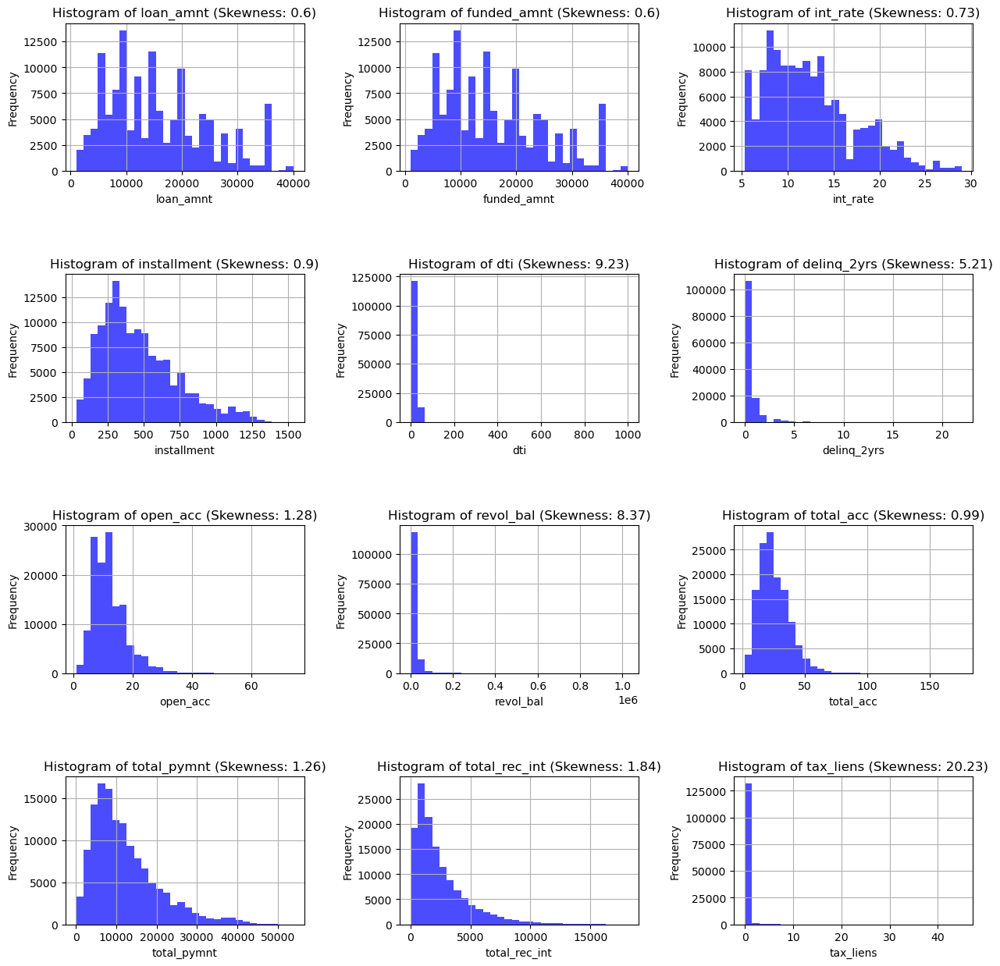

In [31]:
from scipy.stats import skew

columns = df[["loan_amnt", "funded_amnt", "int_rate", "installment", "dti", "delinq_2yrs", 
             "open_acc",  "revol_bal", "total_acc", 
             "total_pymnt", "total_rec_int", "tax_liens"]]
# Create subplots
fig, axs = plt.subplots(nrows=4, ncols=3, figsize=(15, 15))
fig.subplots_adjust(hspace = 0.7, wspace = 0.4)  # Adjust the vertical space between subplots

# Plot histograms and add skewness score
for i, column in enumerate(columns):
    row, col = divmod(i, 3)
    axs[row, col].hist(df[column], bins=30, color='blue', alpha=0.7)
    axs[row, col].set_title(f'Histogram of {column} (Skewness: {round(skew(df[column]), 2)})')
    axs[row, col].set_xlabel(column)
    axs[row, col].set_ylabel('Frequency')
    axs[row, col].grid(True)

# Show the plot
plt.show()

#### Observations:

1. Histogram has been plotted on all the numeric columns in the dataset. And it can be observed that the 'tax_liens' is highly right skewed with a skewness of 20.23.
2. The attributes 'dti', 'deling_2yrs' and "revol_bal" are moderately right skewed.
3. And all the other attributes in the dataset such as "loan_amnt", "funded_amnt", "int_rate", "open_acc", "total_acc", "total_pymnt" and "total_rec_int" are slightly right skewed.
4. The skewness represents that the data indeed has outliers. Outliers can result in skewed distribution. In the later steps outlier analysis will be performed.

#### 2(ii): Univariate analysis - categorical columns
For all the categorical columns in the dataset, univariate analysis is conducted by plotting pie-charts, barplots, countplots and many more. This kind of analysis involves analysing one attribute at a time

#### 'Home_ownership' column

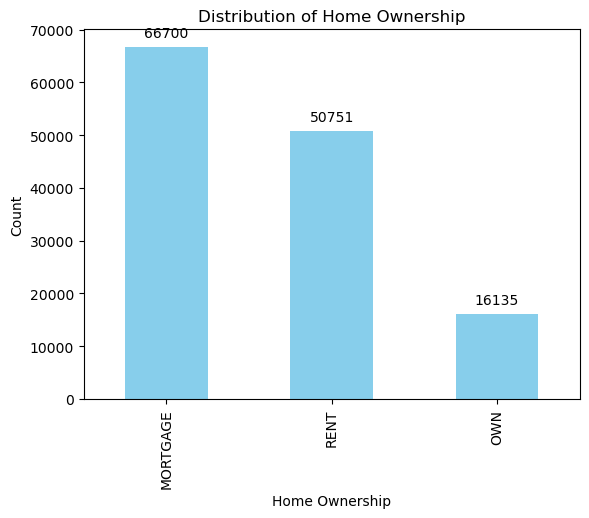

In [32]:
value_counts = df['home_ownership'].value_counts()

# Create a bar plot
ax = value_counts.plot(kind='bar', color='skyblue')

# Add frequency counts on top of each bar
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', xytext=(0, 10), textcoords='offset points')

plt.title('Distribution of Home Ownership')
plt.xlabel('Home Ownership')
plt.ylabel('Count')
plt.show()


#### Observations:

1. The majority of the customers in the dataset are people who belongs to the category 'mortgage' followed by 'rent', this indicates these people are most likely to take loan. 

#### "Grade"

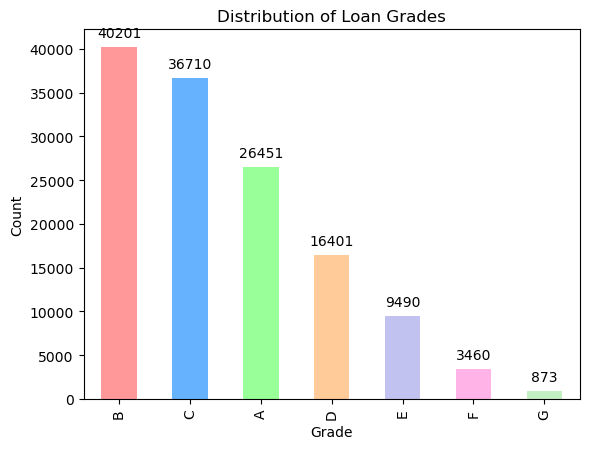

In [33]:
grade_counts = df['grade'].value_counts()

# Create a bar plot
ax = grade_counts.plot(kind='bar', color=['#FF9999', '#66B2FF', '#99FF99', '#FFCC99', '#c2c2f0', '#ffb3e6', '#c2f0c2'])

# Add frequency counts on top of each bar
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', xytext=(0, 10), textcoords='offset points')

plt.title('Distribution of Loan Grades')
plt.xlabel('Grade')
plt.ylabel('Count')
plt.show()


#### Observations:

1. The highest frequency of grades available in the dataset are 'B' followed by 'C', 'A', 'D', 'E', 'F' and 'G'.

#### Verification-status

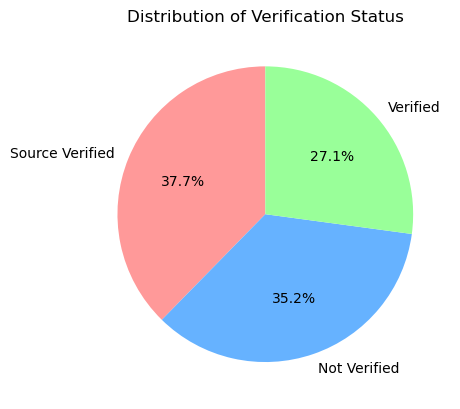

In [34]:
verification_counts = df['verification_status'].value_counts()

# Create a pie chart
plt.pie(verification_counts, labels=verification_counts.index, autopct='%1.1f%%', startangle=90, colors=['#FF9999', '#66B2FF', '#99FF99'])
plt.title('Distribution of Verification Status')
plt.show()

#### Observations:

1. A large percent of customers in the dataset are verfied customers while on the other hand 27.1% customers are not verified. The un-verified customers can pose a threat to the banking system. As there is no enough information available about them.

#### Loan status:

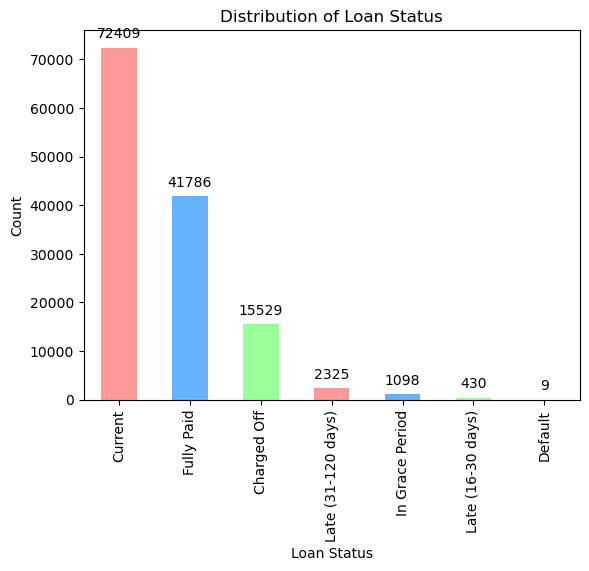

In [35]:
loan_status_counts = df['loan_status'].value_counts()

# Create a bar plot
ax = loan_status_counts.plot(kind='bar', color=['#FF9999', '#66B2FF', '#99FF99'])

# Add frequency counts on top of each bar
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', xytext=(0, 10), textcoords='offset points')

plt.title('Distribution of Loan Status')
plt.xlabel('Loan Status')
plt.ylabel('Count')
plt.show()

#### Observations:

1. Majority people in the dataset are those people who have need to pay the loan-amount.
2. Approximately 40000 thousand people have paid their loans and for approx 15000 people the bank has charged of the loan.
3. Out of all the customers there are approx 3000 customers who have not paid the loan amount due to certain reasons.

#### 'Term'

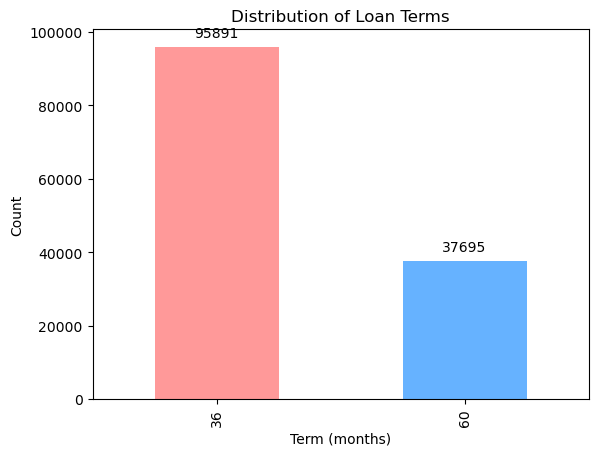

In [36]:
term_counts = df['term'].value_counts()

# Create a bar plot
ax = term_counts.plot(kind='bar', color=['#FF9999', '#66B2FF'])

# Add frequency counts on top of each bar
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', xytext=(0, 10), textcoords='offset points')

plt.title('Distribution of Loan Terms')
plt.xlabel('Term (months)')
plt.ylabel('Count')
plt.show()

#### Observations:
1. Majority of  people prefer to lower term loan compared to higher term laon.

#### 2(iii) Bivariate Analysis 

#### Loan Status Across Loan Terms

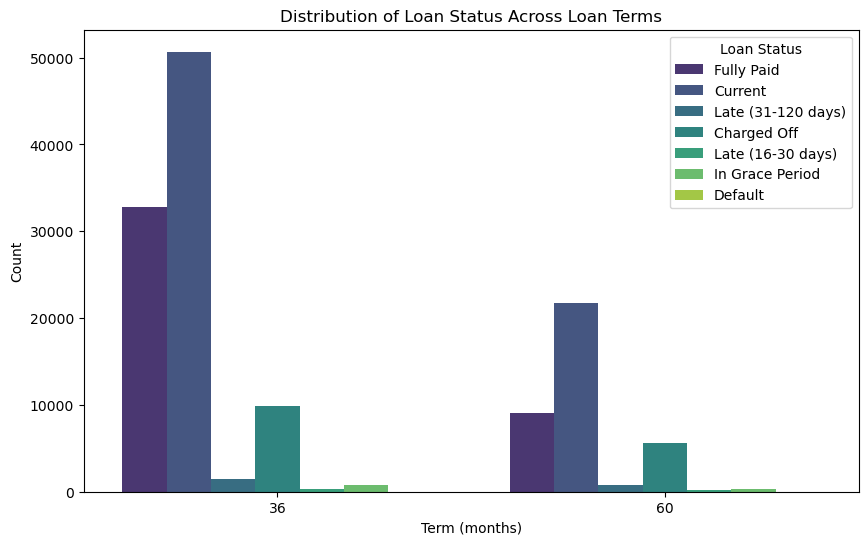

In [37]:
plt.figure(figsize=(10, 6))

# Grouped bar plot
sns.countplot(x='term', hue='loan_status', data=df, palette='viridis')

plt.title('Distribution of Loan Status Across Loan Terms')
plt.xlabel('Term (months)')
plt.ylabel('Count')
plt.legend(title='Loan Status')
plt.show()

observation: Lower term months is usually preferred by customers across all the categories to repay the loan.

#### Distribution of Loan Status Across Homeownership

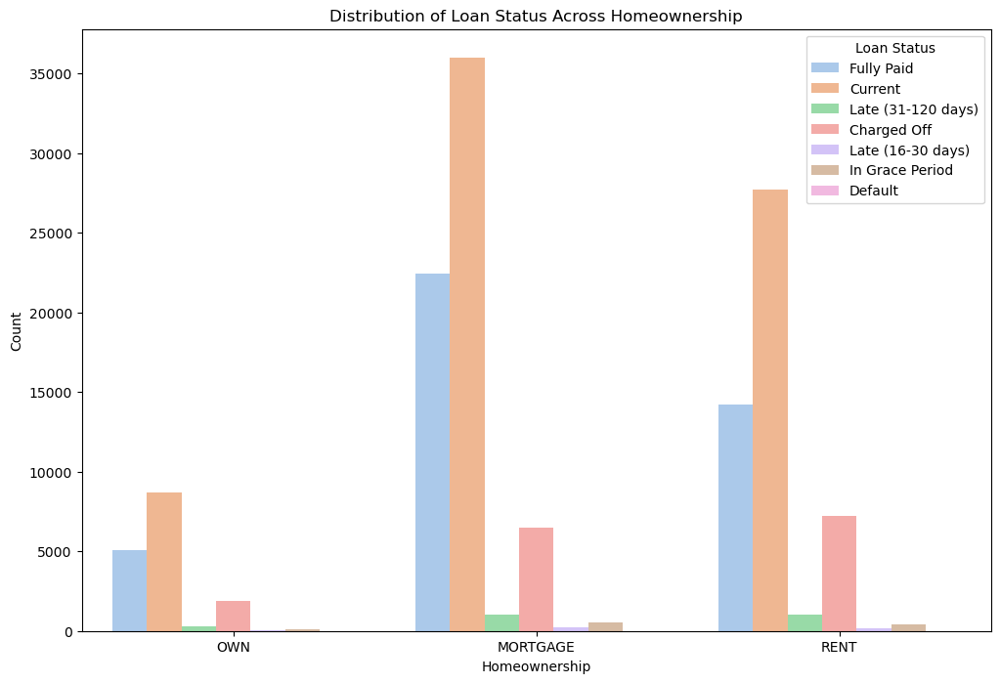

In [38]:
plt.figure(figsize=(12, 8))

# Grouped bar plot
sns.countplot(x='home_ownership', hue='loan_status', data=df, palette='pastel')

plt.title('Distribution of Loan Status Across Homeownership')
plt.xlabel('Homeownership')
plt.ylabel('Count')
plt.legend(title='Loan Status')
plt.show()

The customers which fall under the category of mortgage tend to take more loan compared to other segment of customers. Moreover active/current customers tend to take more loan compared to other segment of customers.

#### Loan Status Across Grades

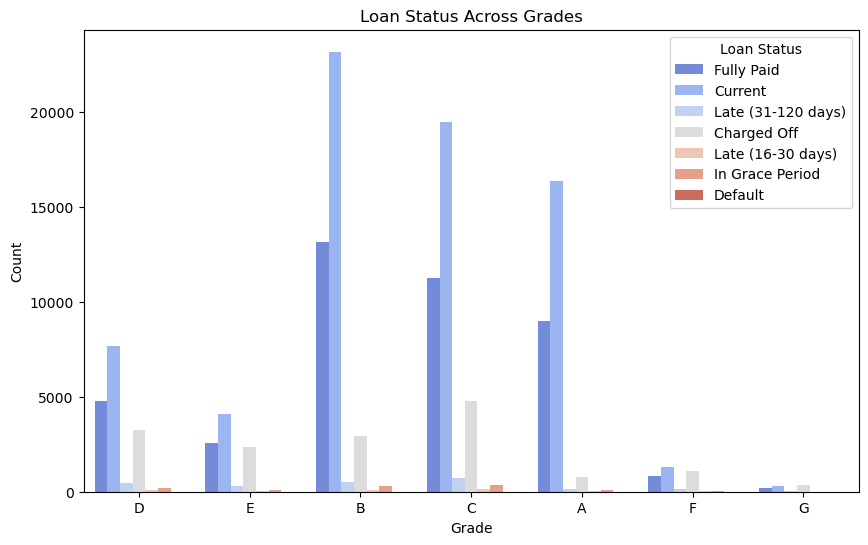

In [39]:
plt.figure(figsize=(10, 6))

# Grouped bar plot
sns.countplot(x='grade', hue='loan_status', data=df, palette='coolwarm')

plt.title('Loan Status Across Grades')
plt.xlabel('Grade')
plt.ylabel('Count')
plt.legend(title='Loan Status')
plt.show()

Majority of the people in the dataset are the people who are currently repaying the loan and who have already paid the loan fall under the grade B followed by C and A.

#### Loan Amount Across Homeownership

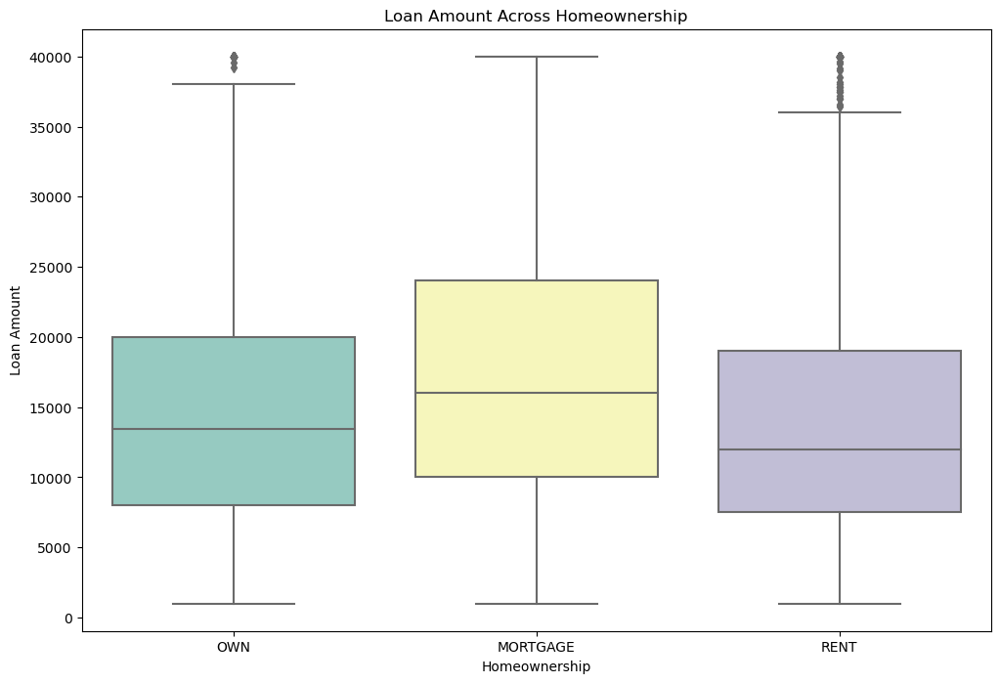

In [40]:

plt.figure(figsize=(12, 8))
# Box plot
sns.boxplot(x='home_ownership', y='loan_amnt', data=df, palette='Set3')

plt.title('Loan Amount Across Homeownership')
plt.xlabel('Homeownership')
plt.ylabel('Loan Amount')
plt.show()


People who fall under the category mortagage tend to get more loan_amount sanctioned compared to other categories.

#### Loan Amount Across Loan Terms

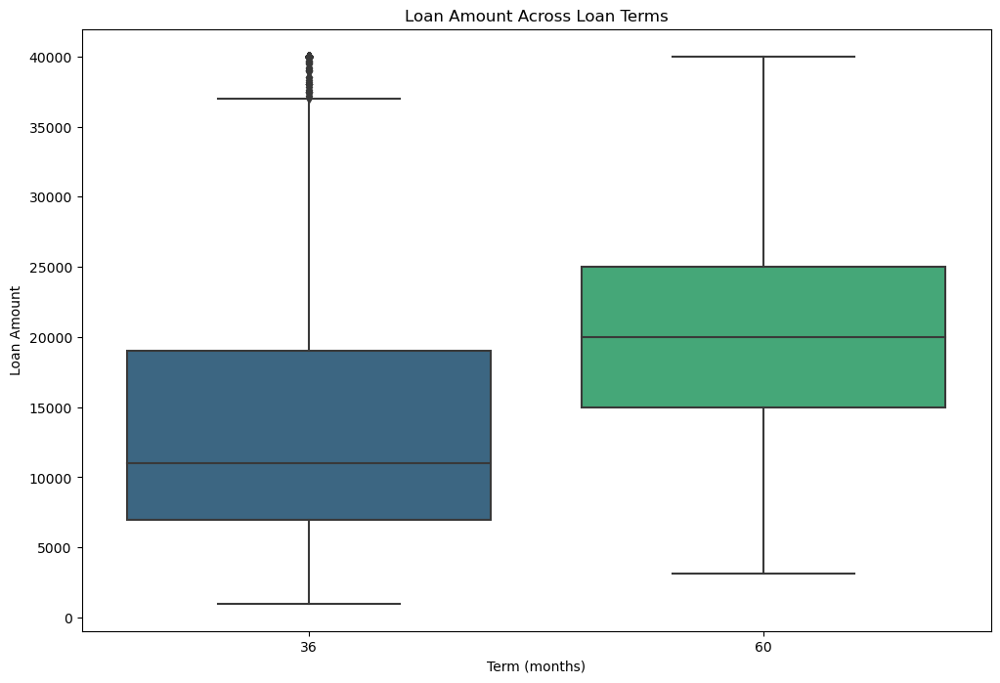

In [41]:
plt.figure(figsize=(12, 8))

# Box plot
sns.boxplot(x='term', y='loan_amnt', data=df, palette='viridis')

plt.title('Loan Amount Across Loan Terms')
plt.xlabel('Term (months)')
plt.ylabel('Loan Amount')
plt.show()

Customers with higher loan_amount sancationed prefer to repay the loan in longer duration of time.

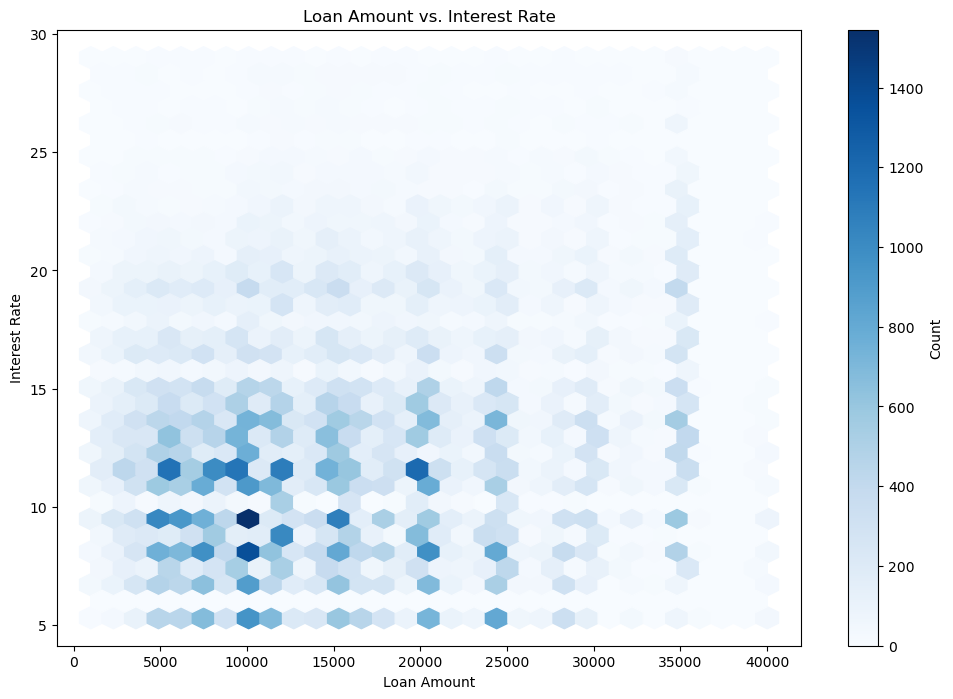

In [42]:
plt.figure(figsize=(12, 8))

# Hexbin plot
plt.hexbin(df['loan_amnt'], df['int_rate'], gridsize=30, cmap='Blues')

plt.title('Loan Amount vs. Interest Rate')
plt.xlabel('Loan Amount')
plt.ylabel('Interest Rate')
plt.colorbar(label='Count')
plt.show()

There is no specific relation between loan_amount requested and interest_rate. It can be observed for few data points Lower loan_amount have higher interest rates and vice versa.

#### Annual Income Across Homeownership 

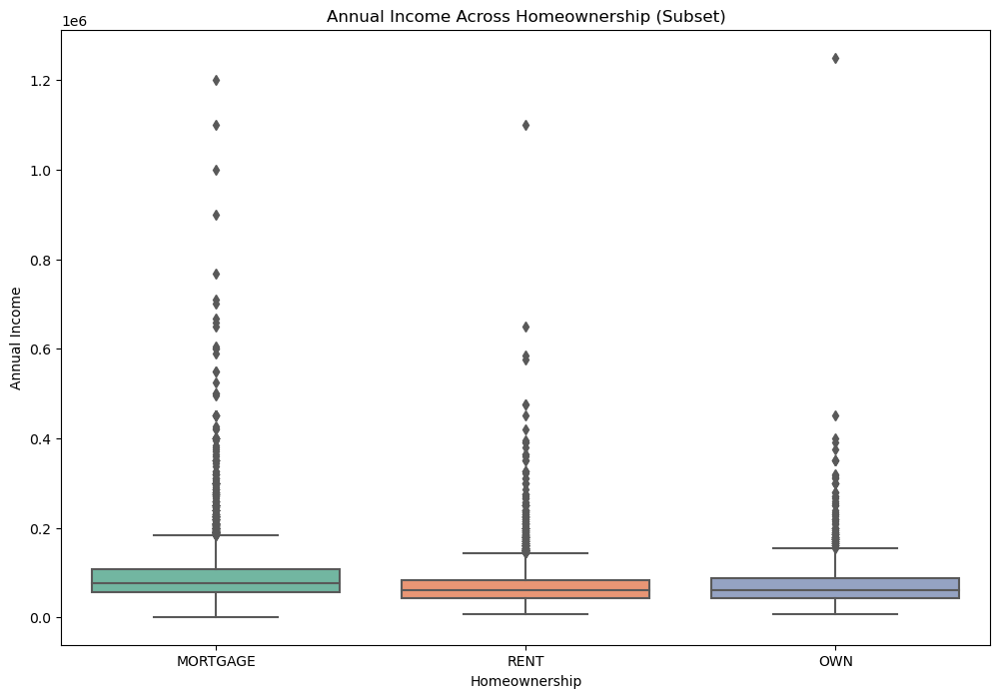

In [43]:
subset_df = df.sample(frac=0.1, random_state=42)  # Use a fraction that suits your needs

plt.figure(figsize=(12, 8))

# Box plot
sns.boxplot(x='home_ownership', y='annual_inc', data=subset_df, palette='Set2')

plt.title('Annual Income Across Homeownership (Subset)')
plt.xlabel('Homeownership')
plt.ylabel('Annual Income')
plt.show()

People who fall under the category of mortgage tend to higher annual_income.

#### Loan Amount Across Grades

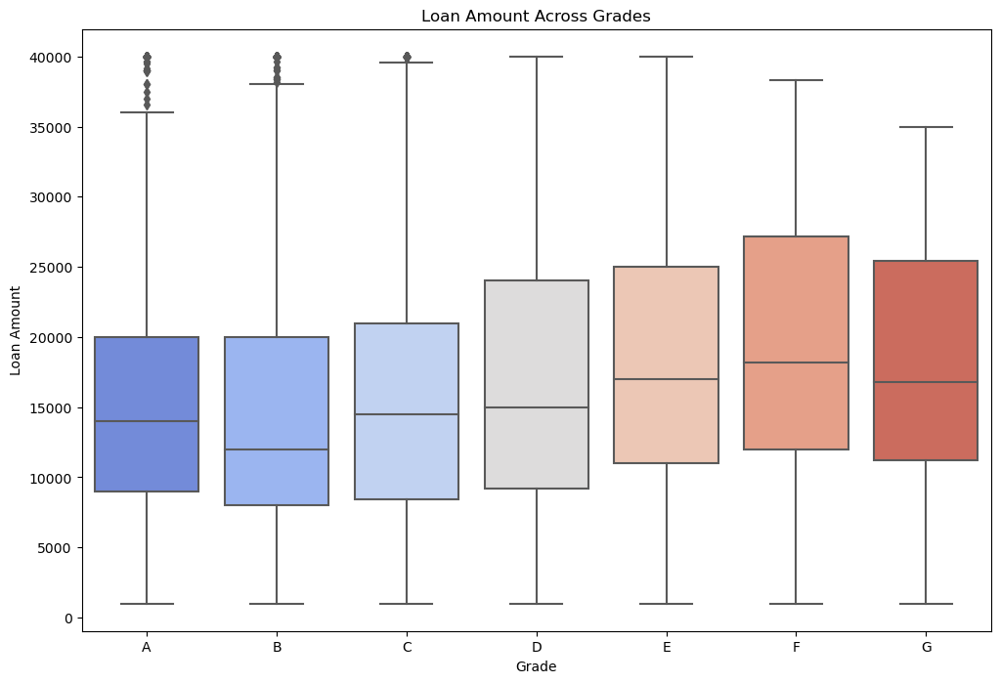

In [44]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming df is your DataFrame
plt.figure(figsize=(12, 8))

# Box plot
sns.boxplot(x='grade', y='loan_amnt', data=df, order=['A', 'B', 'C', 'D', 'E', 'F', 'G'], palette='coolwarm')

plt.title('Loan Amount Across Grades')
plt.xlabel('Grade')
plt.ylabel('Loan Amount')
plt.show()


People with Grade F followed by Grade E ask for greater laon_amount compared to other categories.

#### Loan Amount vs. Annual Income

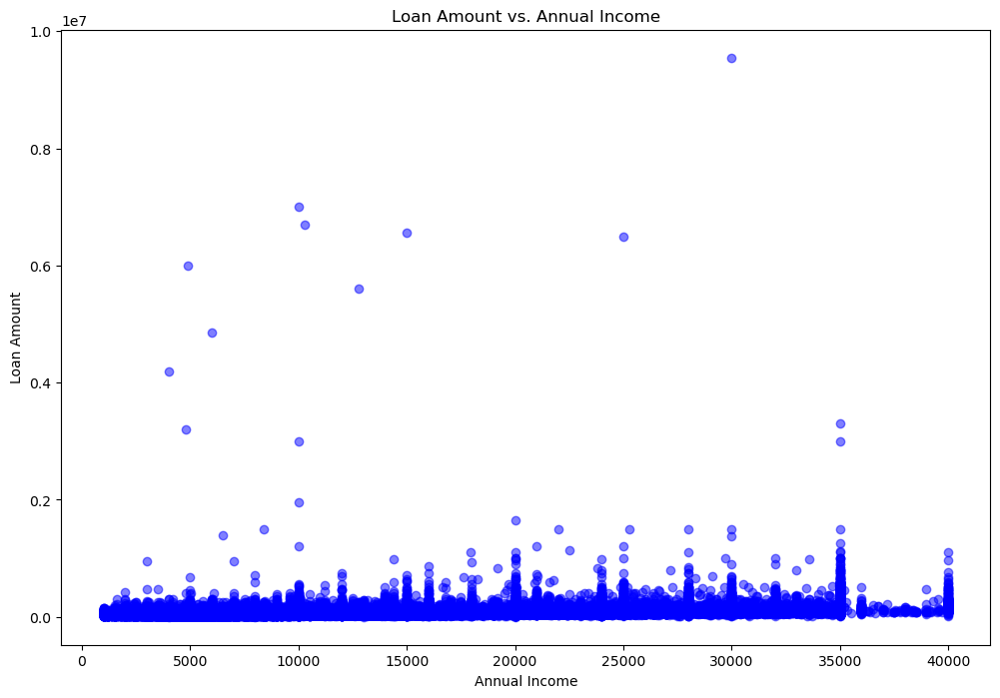

In [45]:
plt.figure(figsize=(12, 8))

# Scatter plot
plt.scatter(df['loan_amnt'], df['annual_inc'], alpha=0.5, color='blue')

plt.title('Loan Amount vs. Annual Income')
plt.xlabel('Annual Income')
plt.ylabel('Loan Amount')
plt.show()

Majority of the people in the dataset with all annual-income categories request for lower loan_amounts. It can be found that there few exceptions aswell where higher loan_amounts have also been requested. A deep analysis can be conducted in order to find which grade people are these who are asking for more laon_amount

## --------------------------------------------------------------------------------------------------------------------------

### 3. Data transformation

Convert the column to numeric type,  converting date format

In [46]:
import pandas as pd

# Create a binary target variable
df['loan_default'] = df['loan_status'].apply(lambda x: 1 if x not in ['Fully Paid', 'Current'] else 0)

In [47]:
df['loan_default'].value_counts()

0    114195
1     19391
Name: loan_default, dtype: int64

### We have created a new target feature : "loan_default."
#### It Has binary values where 0 is for "Fully Paid" & "Current" and 1 for any form of default, such as "Charged Off," "Default," "Late (31-120 days)," etc. 

In [48]:
#As the data from 'loan_status' is imputed to 'loan_default', we wil drop 'loan_status'
df.drop('loan_status', axis=1, inplace=True)


In [49]:
df

,loan_amnt,funded_amnt,term,int_rate,installment,grade,home_ownership,annual_inc,verification_status,issue_d,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,total_pymnt,total_rec_int,tax_liens,issue_month,issue_year,earliest_cr_line_month,earliest_cr_line_year,loan_default
0,10000.0,10000.0,60,19.53,262.34,D,OWN,52000.0,Source Verified,2016-03-01,15.00,0.0,2000-10-01,1.0,4.0,2.0,1077.0,35.90%,12.0,w,11127.83,1127.83,0.0,3,2016,10,2000,0
1,35000.0,35000.0,60,20.75,941.96,E,MORTGAGE,85000.0,Source Verified,2016-03-01,24.98,0.0,2008-12-01,1.0,9.0,0.0,10167.0,46.60%,19.0,w,37226.47,2226.47,0.0,3,2016,12,2008,0
2,20000.0,20000.0,60,9.16,416.73,B,MORTGAGE,77000.0,Not Verified,2016-03-01,13.75,0.0,2005-03-01,1.0,14.0,0.0,4204.0,13.90%,19.0,w,9147.70,2848.11,0.0,3,2016,3,2005,0
3,17475.0,17475.0,60,11.47,384.06,B,MORTGAGE,41682.0,Verified,2016-03-01,30.06,0.0,1976-02-01,0.0,10.0,0.0,24431.0,27.60%,18.0,w,8432.61,3146.84,0.0,3,2016,2,1976,0
4,8000.0,8000.0,36,9.16,255.00,B,RENT,72000.0,Source Verified,2016-03-01,22.63,0.0,2007-11-01,0.0,4.0,0.0,19735.0,98.70%,12.0,w,5601.86,975.31,0.0,3,2016,11,2007,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
133827,16800.0,16800.0,60,18.49,431.11,E,MORTGAGE,42000.0,Verified,2016-01-01,19.52,0.0,2003-04-01,0.0,11.0,0.0,7352.0,45.90%,16.0,w,16760.49,4698.08,0.0,1,2016,4,2003,0
133828,7225.0,7225.0,36,11.22,237.30,B,MORTGAGE,55000.0,Source Verified,2016-01-01,14.44,0.0,2001-06-01,1.0,10.0,0.0,25113.0,76.30%,15.0,f,4266.90,956.09,0.0,1,2016,6,2001,1
133831,12800.0,12800.0,36,13.18,432.40,C,MORTGAGE,46000.0,Source Verified,2016-01-01,22.57,1.0,2006-11-01,2.0,11.0,1.0,9455.0,64.30%,13.0,w,10800.63,2457.68,1.0,1,2016,11,2006,0
133832,35000.0,35000.0,36,14.48,1204.40,C,MORTGAGE,110000.0,Source Verified,2016-01-01,15.81,0.0,1994-05-01,0.0,10.0,0.0,12310.0,45.80%,46.0,w,37977.46,2977.46,0.0,1,2016,5,1994,0


In [50]:
df.head()

,loan_amnt,funded_amnt,term,int_rate,installment,grade,home_ownership,annual_inc,verification_status,issue_d,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,total_pymnt,total_rec_int,tax_liens,issue_month,issue_year,earliest_cr_line_month,earliest_cr_line_year,loan_default
0,10000.0,10000.0,60,19.53,262.34,D,OWN,52000.0,Source Verified,2016-03-01,15.00,0.0,2000-10-01,1.0,4.0,2.0,1077.0,35.90%,12.0,w,11127.83,1127.83,0.0,3,2016,10,2000,0
1,35000.0,35000.0,60,20.75,941.96,E,MORTGAGE,85000.0,Source Verified,2016-03-01,24.98,0.0,2008-12-01,1.0,9.0,0.0,10167.0,46.60%,19.0,w,37226.47,2226.47,0.0,3,2016,12,2008,0
2,20000.0,20000.0,60,9.16,416.73,B,MORTGAGE,77000.0,Not Verified,2016-03-01,13.75,0.0,2005-03-01,1.0,14.0,0.0,4204.0,13.90%,19.0,w,9147.70,2848.11,0.0,3,2016,3,2005,0
3,17475.0,17475.0,60,11.47,384.06,B,MORTGAGE,41682.0,Verified,2016-03-01,30.06,0.0,1976-02-01,0.0,10.0,0.0,24431.0,27.60%,18.0,w,8432.61,3146.84,0.0,3,2016,2,1976,0
4,8000.0,8000.0,36,9.16,255.00,B,RENT,72000.0,Source Verified,2016-03-01,22.63,0.0,2007-11-01,0.0,4.0,0.0,19735.0,98.70%,12.0,w,5601.86,975.31,0.0,3,2016,11,2007,0


#### 3.1 Transform 'revol_util' column

In [51]:
# examine revol_util
# Remove unnecessary symbols and keep only numbers
df['revol_util'] = df['revol_util'].replace('[%]', '', regex=True)

# Convert the column to numeric type
df['revol_util'] = pd.to_numeric(df['revol_util'], errors='coerce')

# Display the modified DataFrame
print(df['revol_util'].unique())


[ 35.9  46.6  13.9 ... 119.6 112.3 106.1]


#### 3.2 Transform 'grade' column

In [52]:
df['grade'].value_counts()

B    40201
C    36710
A    26451
D    16401
E     9490
F     3460
G      873
Name: grade, dtype: int64

In [53]:
grade_mapping = {
    'A': 0,
    'B': 1,
    'C': 2,
    'D': 3,
    'E': 4,
    'F': 5,
    'G': 6,
}

# Map 'grade' values to numeric values
df['grade'] = df['grade'].map(grade_mapping)

#### 3.3 Transform 'home_ownership' column

In [54]:
df['home_ownership'].value_counts()

MORTGAGE    66700
RENT        50751
OWN         16135
Name: home_ownership, dtype: int64

In [55]:
df['loan_default'].value_counts()

0    114195
1     19391
Name: loan_default, dtype: int64

In [56]:
home_ownership_mapping = {
    'MORTGAGE': 0,
    'RENT': 1,
    'OWN': 2,
}

# Map 'grade' values to numeric values
df['home_ownership'] = df['home_ownership'].map(home_ownership_mapping)

#### 3.4 transform 'verification_status' column

In [57]:
# Combine 'Source Verified' and 'Verified' into a single category
df['verification_status'] = df['verification_status'].replace({'Source Verified': 'Verified'})

In [58]:
df['verification_status'].value_counts()

Verified        86559
Not Verified    47027
Name: verification_status, dtype: int64

In [59]:
verification_status_mapping = {
    'Not Verified': 0,
    'Verified': 1,
}

# Map 'grade' values to numeric values
df['verification_status'] = df['verification_status'].map(verification_status_mapping)

In [60]:
df.head()

,loan_amnt,funded_amnt,term,int_rate,installment,grade,home_ownership,annual_inc,verification_status,issue_d,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,total_pymnt,total_rec_int,tax_liens,issue_month,issue_year,earliest_cr_line_month,earliest_cr_line_year,loan_default
0,10000.0,10000.0,60,19.53,262.34,3,2,52000.0,1,2016-03-01,15.00,0.0,2000-10-01,1.0,4.0,2.0,1077.0,35.9,12.0,w,11127.83,1127.83,0.0,3,2016,10,2000,0
1,35000.0,35000.0,60,20.75,941.96,4,0,85000.0,1,2016-03-01,24.98,0.0,2008-12-01,1.0,9.0,0.0,10167.0,46.6,19.0,w,37226.47,2226.47,0.0,3,2016,12,2008,0
2,20000.0,20000.0,60,9.16,416.73,1,0,77000.0,0,2016-03-01,13.75,0.0,2005-03-01,1.0,14.0,0.0,4204.0,13.9,19.0,w,9147.70,2848.11,0.0,3,2016,3,2005,0
3,17475.0,17475.0,60,11.47,384.06,1,0,41682.0,1,2016-03-01,30.06,0.0,1976-02-01,0.0,10.0,0.0,24431.0,27.6,18.0,w,8432.61,3146.84,0.0,3,2016,2,1976,0
4,8000.0,8000.0,36,9.16,255.00,1,1,72000.0,1,2016-03-01,22.63,0.0,2007-11-01,0.0,4.0,0.0,19735.0,98.7,12.0,w,5601.86,975.31,0.0,3,2016,11,2007,0


#### 3.5 transform initial_list_status column

In [61]:
df['initial_list_status'].value_counts()

w    112706
f     20880
Name: initial_list_status, dtype: int64

In [62]:
initial_list_status_mapping = {
    'w': 0,
    'f': 1,
}

# Map 'grade' values to numeric values
df['initial_list_status'] = df['initial_list_status'].map(initial_list_status_mapping)

In [63]:
df.head()

,loan_amnt,funded_amnt,term,int_rate,installment,grade,home_ownership,annual_inc,verification_status,issue_d,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,total_pymnt,total_rec_int,tax_liens,issue_month,issue_year,earliest_cr_line_month,earliest_cr_line_year,loan_default
0,10000.0,10000.0,60,19.53,262.34,3,2,52000.0,1,2016-03-01,15.00,0.0,2000-10-01,1.0,4.0,2.0,1077.0,35.9,12.0,0,11127.83,1127.83,0.0,3,2016,10,2000,0
1,35000.0,35000.0,60,20.75,941.96,4,0,85000.0,1,2016-03-01,24.98,0.0,2008-12-01,1.0,9.0,0.0,10167.0,46.6,19.0,0,37226.47,2226.47,0.0,3,2016,12,2008,0
2,20000.0,20000.0,60,9.16,416.73,1,0,77000.0,0,2016-03-01,13.75,0.0,2005-03-01,1.0,14.0,0.0,4204.0,13.9,19.0,0,9147.70,2848.11,0.0,3,2016,3,2005,0
3,17475.0,17475.0,60,11.47,384.06,1,0,41682.0,1,2016-03-01,30.06,0.0,1976-02-01,0.0,10.0,0.0,24431.0,27.6,18.0,0,8432.61,3146.84,0.0,3,2016,2,1976,0
4,8000.0,8000.0,36,9.16,255.00,1,1,72000.0,1,2016-03-01,22.63,0.0,2007-11-01,0.0,4.0,0.0,19735.0,98.7,12.0,0,5601.86,975.31,0.0,3,2016,11,2007,0


## -------------------------------------------------------------------------------------------------------------------------------------

### 4. Correlation analysis

In [64]:
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split

# Assuming 'df' is your DataFrame
# Ensure that the target column is correctly named in your DataFrame
target_column = 'loan_default'

# Check if the target column exists in the DataFrame
if target_column not in df.columns:
    raise KeyError(f"The specified target column '{target_column}' is not present in the DataFrame.")

# Select relevant features
selected_features = [ 'loan_amnt', 'funded_amnt', 'term', 'int_rate', 'installment','grade', 'home_ownership',
                     'annual_inc', 'verification_status', 'dti', 'delinq_2yrs', 'earliest_cr_line', 'inq_last_6mths',
                     'open_acc', 'pub_rec', 'issue_d', 'total_pymnt', 'total_rec_int', 'revol_bal', 'revol_util',
                     'total_acc', 'initial_list_status', 'tax_liens']
       

# Subset the DataFrame with selected features and target variable
subset_df = df[selected_features + [target_column]]

# Encode categorical variables if needed (e.g., one-hot encoding)
subset_df = pd.get_dummies(subset_df, columns=['grade', 'home_ownership', 'verification_status', 'initial_list_status'], drop_first=True)

# Split the data into features (X) and target variable (y)
X = subset_df.drop(target_column, axis=1)
y = subset_df[target_column]

# Calculate correlation with the target variable
correlation_with_target = subset_df.corr()[target_column].abs().sort_values(ascending=False)

# Print correlation with the target variable
print("Correlation with the target variable:")
print(correlation_with_target)


Correlation with the target variable:
loan_default             1.000000
total_pymnt              0.253475
int_rate                 0.252807
grade_4                  0.119159
grade_5                  0.108068
grade_3                  0.101293
grade_1                  0.090833
dti                      0.088598
inq_last_6mths           0.086460
verification_status_1    0.083442
term                     0.069613
grade_6                  0.065744
home_ownership_1         0.063447
initial_list_status_1    0.060691
installment              0.045280
revol_util               0.038427
revol_bal                0.030662
grade_2                  0.030479
annual_inc               0.029158
funded_amnt              0.027915
loan_amnt                0.027915
pub_rec                  0.026790
open_acc                 0.026779
delinq_2yrs              0.016119
total_rec_int            0.012830
total_acc                0.008237
tax_liens                0.005930
home_ownership_2         0.001051
Name: loan

## 5.Recursive Feature Elimination (RFE)

In [65]:
from sklearn.feature_selection import RFE
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
import pandas as pd

# Assuming 'df' is your DataFrame
# Ensure that the target column is correctly named in your DataFrame
target_column = 'loan_default'

# Check if the target column exists in the DataFrame
if target_column not in df.columns:
    raise KeyError(f"The specified target column '{target_column}' is not present in the DataFrame.")

# Select relevant features
selected_features = ['loan_amnt', 'funded_amnt', 'term', 'int_rate', 'installment', 'grade', 'home_ownership',
                     'annual_inc', 'verification_status', 'dti', 'delinq_2yrs', 'inq_last_6mths',
                     'open_acc', 'pub_rec', 'total_pymnt', 'total_rec_int', 'revol_bal', 'revol_util',
                     'total_acc', 'initial_list_status', 'tax_liens']

# Subset the DataFrame with selected features and target variable
subset_df = df[selected_features + [target_column]]

# Encode categorical variables if needed (e.g., one-hot encoding)
subset_df = pd.get_dummies(subset_df, columns=['grade', 'home_ownership', 'verification_status', 'initial_list_status'], drop_first=True)

# Split the data into features (X) and target variable (y)
X = subset_df.drop(target_column, axis=1)
y = subset_df[target_column]

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create a linear regression model
lr_model = LinearRegression()

# Use RFE for feature selection
num_selected_features = 10  # Adjust as needed
rfe = RFE(estimator=lr_model, n_features_to_select=num_selected_features)
X_rfe = rfe.fit_transform(X_train, y_train)

# Get the selected features
selected_features_rfe = X.columns[rfe.support_]

# Print selected features using RFE
print(f"Selected features using RFE with Linear Regression ({num_selected_features} features):")
print(selected_features_rfe)


Selected features using RFE with Linear Regression (10 features):
Index(['int_rate', 'inq_last_6mths', 'grade_2', 'grade_3', 'grade_4',
       'grade_5', 'grade_6', 'home_ownership_1', 'home_ownership_2',
       'initial_list_status_1'],
      dtype='object')


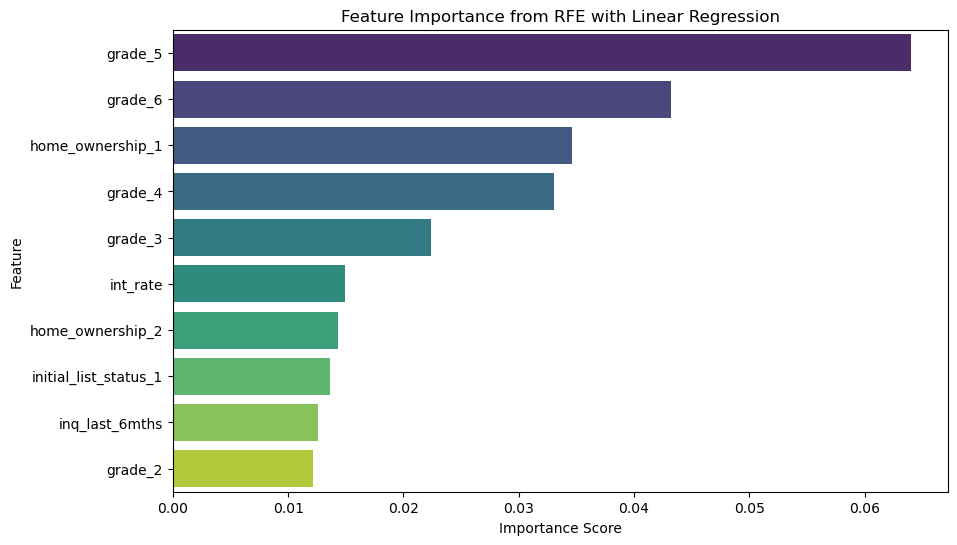

In [66]:
# Plot a bar plot
feature_importance_df = pd.DataFrame({'Feature': selected_features_rfe, 'Importance': rfe.estimator_.coef_})

# Sort the DataFrame by importance scores in descending order
feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

# Plot a bar plot
plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=feature_importance_df, palette='viridis')
plt.title('Feature Importance from RFE with Linear Regression')
plt.xlabel('Importance Score')
plt.ylabel('Feature')
plt.show()

In [67]:
# Columns to keep
desired_columns = ['loan_amnt','term','int_rate','grade','verification_status','dti','inq_last_6mths',
                    'loan_status','issue_d','total_pymnt', 'loan_default', 'int_rate','grade_2', 'grade_3', 'grade_4',
                    'grade_5', 'grade_6', 'home_ownership_1', 'home_ownership_2',
                    'initial_list_status_1']

columns_before_drop = df.columns # Store the columns before dropping

df.drop(df.columns.difference(desired_columns), axis=1, inplace=True)

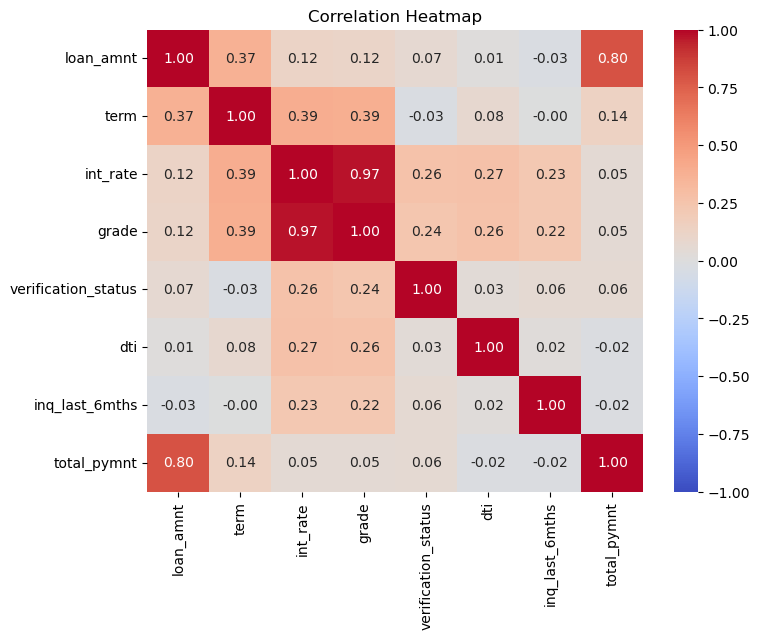

In [68]:
import seaborn as sns
import matplotlib.pyplot as plt

# Select features excluding the target variable
features = df.drop(target_column, axis=1)

# Calculate the correlation matrix
correlation_matrix = features.corr()

# Create a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", vmin=-1, vmax=1)
plt.title('Correlation Heatmap')
plt.show()


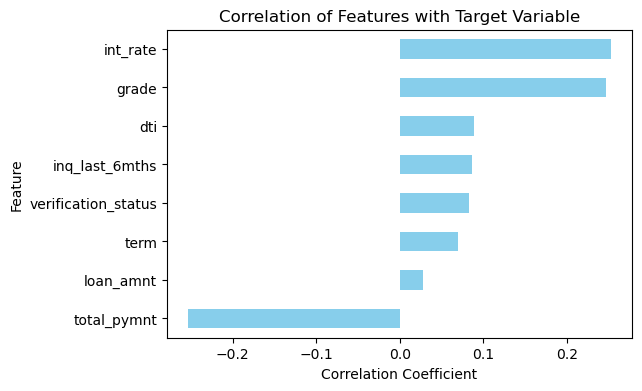

                     Correlation with Target
loan_amnt                           0.027915
term                                0.069613
int_rate                            0.252807
grade                               0.247358
verification_status                 0.083442
dti                                 0.088598
inq_last_6mths                      0.086460
total_pymnt                        -0.253475


In [69]:
# Calculate the correlation of features with the target variable
correlation_with_target = df.drop(target_column, axis=1).corrwith(df[target_column])

# Create a bar plot
plt.figure(figsize=(6, 4))
correlation_with_target.sort_values().plot(kind='barh', color='skyblue')
plt.title('Correlation of Features with Target Variable')
plt.xlabel('Correlation Coefficient')
plt.ylabel('Feature')
plt.show()

# Display a correlation table
correlation_table = pd.DataFrame({'Correlation with Target': correlation_with_target})
print(correlation_table)


##### Observations:

1. A heatmap has been plotted in order to understand the correlation among the variables w.r.t target variable. From the heatmap it can be observed that the features 'int_rate' and 'grade' have highest positive correlation w.r.t. target variable. Features like ' verification_status', 'dti' and 'inq_last_6mths' have moderate positive corelation w.r.t. target variable. Feature  'total_pymnt' has negative correlation w.r.t target variable.

2. Recursive feature elimination has also been performed and a bar plot has been plotted showing the rank of most to least important features. And, it can be observed that 'int_rate' and has the highest ranking of 0.25 followed by "grade", verification_status', 'dti' and 'inq_last_6mths and so on.

3. Based on this analysis few important decisions have been made on which attributes to choose for data modelling.


In [70]:
df

,loan_amnt,term,int_rate,grade,verification_status,issue_d,dti,inq_last_6mths,total_pymnt,loan_default
0,10000.0,60,19.53,3,1,2016-03-01,15.00,1.0,11127.83,0
1,35000.0,60,20.75,4,1,2016-03-01,24.98,1.0,37226.47,0
2,20000.0,60,9.16,1,0,2016-03-01,13.75,1.0,9147.70,0
3,17475.0,60,11.47,1,1,2016-03-01,30.06,0.0,8432.61,0
4,8000.0,36,9.16,1,1,2016-03-01,22.63,0.0,5601.86,0
...,...,...,...,...,...,...,...,...,...,...
133827,16800.0,60,18.49,4,1,2016-01-01,19.52,0.0,16760.49,0
133828,7225.0,36,11.22,1,1,2016-01-01,14.44,1.0,4266.90,1
133831,12800.0,36,13.18,2,1,2016-01-01,22.57,2.0,10800.63,0
133832,35000.0,36,14.48,2,1,2016-01-01,15.81,0.0,37977.46,0


In [71]:
columns = ['loan_amnt', 'term','int_rate','grade','verification_status','dti','inq_last_6mths','issue_d','total_pymnt', 'loan_default']
summary_statistics = df[columns].describe()
summary_statistics

,loan_amnt,term,int_rate,grade,verification_status,dti,inq_last_6mths,total_pymnt,loan_default
count,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000,133586.000000
mean,15591.532608,42.772267,12.469859,1.671747,0.647965,19.547298,0.576093,12099.597892,0.145157
std,8856.261799,10.801466,4.824895,1.315232,0.477607,9.966771,0.878692,8149.554605,0.352261
min,1000.000000,36.000000,5.320000,0.000000,0.000000,-1.000000,0.000000,34.410000,0.000000
25%,8400.000000,36.000000,8.490000,1.000000,0.000000,12.640000,0.000000,6174.890000,0.000000
50%,14400.000000,36.000000,11.990000,2.000000,1.000000,18.760000,0.000000,10148.190000,0.000000
75%,21000.000000,60.000000,15.310000,2.000000,1.000000,25.770000,1.000000,16080.532305,0.000000
max,40000.000000,60.000000,28.990000,6.000000,1.000000,999.000000,5.000000,53853.804610,1.000000


### ----------------------------------------------------------------------------------------------------------------------------

### 6.Outlier Detection
Two approches have been used to find out outliers in the data.
1. Inter quartile range method
2. Box plot

#### 6.1 IQR method

In [72]:
def find_outliers(df, columns):
    outlier_info = {}

    for column in columns:
        Q1 = df[column].quantile(0.25)
        Q3 = df[column].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - (1.5 * IQR)
        upper_bound = Q3 + (1.5 * IQR)
        outliers = (df[column] < lower_bound) | (df[column] > upper_bound)
        outlier_count = outliers.sum()

        outlier_info[column] = {
            'outlier_count': outlier_count,
            'IQR': IQR,
            'Q1': Q1,
            'Q3': Q3,
            'lower_bound': lower_bound,
            'upper_bound': upper_bound
        }

    return outlier_info

# Specify the columns for which you want to find outliers
outlier_columns = ['loan_amnt','term','int_rate','grade','verification_status','dti','inq_last_6mths',
                    'issue_d','total_pymnt']

outlier_info = find_outliers(df, outlier_columns)

for column, info in outlier_info.items():
    print(f"Column: {column}")
    print(f"Count of outliers: {info['outlier_count']}")
    print(f"IQR: {info['IQR']}")
    print(f"Q1: {info['Q1']}")
    print(f"Q3: {info['Q3']}")
    print(f"Lower Bound: {info['lower_bound']}")
    print(f"Upper Bound: {info['upper_bound']}\n")



Column: loan_amnt
Count of outliers: 420
IQR: 12600.0
Q1: 8400.0
Q3: 21000.0
Lower Bound: -10500.0
Upper Bound: 39900.0

Column: term
Count of outliers: 0
IQR: 24.0
Q1: 36.0
Q3: 60.0
Lower Bound: 0.0
Upper Bound: 96.0

Column: int_rate
Count of outliers: 1673
IQR: 6.82
Q1: 8.49
Q3: 15.31
Lower Bound: -1.7400000000000002
Upper Bound: 25.54

Column: grade
Count of outliers: 13823
IQR: 1.0
Q1: 1.0
Q3: 2.0
Lower Bound: -0.5
Upper Bound: 3.5

Column: verification_status
Count of outliers: 0
IQR: 1.0
Q1: 0.0
Q3: 1.0
Lower Bound: -1.5
Upper Bound: 2.5

Column: dti
Count of outliers: 707
IQR: 13.129999999999999
Q1: 12.64
Q3: 25.77
Lower Bound: -7.055
Upper Bound: 45.465

Column: inq_last_6mths
Count of outliers: 5623
IQR: 1.0
Q1: 0.0
Q3: 1.0
Lower Bound: -1.5
Upper Bound: 2.5

Column: issue_d
Count of outliers: 0
IQR: 29 days 00:00:00
Q1: 2016-02-01 00:00:00
Q3: 2016-03-01 00:00:00
Lower Bound: 2015-12-19 12:00:00
Upper Bound: 2016-04-13 12:00:00

Column: total_pymnt
Count of outliers: 4729
IQ

#### 6.2 Box plot method

In [73]:
# List of loan-related columns to create box plots
loan_columns = [ 'loan_amnt','term','int_rate','grade','verification_status','dti','inq_last_6mths',
                    'issue_d','total_pymnt']

# Loop through the car-related columns and create a box plot for each one
for column in loan_columns:
    fig = px.box(df, y=column)
    fig.update_layout(
        autosize=False,
        width=800,
        height=600,
        title='Box plot of ' + column,
        xaxis_title=column,
        yaxis_title='Value'
    )

    # Show the plot
    fig.show()

#### Observations:

Outlier analysis has been performed on all the numeric features of the dataset. Both the approches show us that the data indeed has many outliers. The value which resides below the lower bound and the values that resides above the upper bound are considered to be outliers. Based on the calculations made by the Inter quartile range method and box plot method the number of outliers in each column is:

1. Column: loan_amnt, Count of outliers: 420
2. Column: term , Count of outliers: 0
3. Column: int_rate, Count of outliers: 1673
4. Column: grade, Count of outliers: 13823
5. Column: verification_status, Count of outliers: 0
6. Column: dti, Count of outliers: 707
7. Column: inq_last_6mths, Count of outliers: 5623
8. Column: issue_d, Count of outliers: 0
10. Column: total_pymnt, Count of outliers: 4729

The outliers present in the data needs to be addressed using suitable techniques. 

### ----------------------------------------------------------------------------------------------------------------------------------------------------------

### 7. Outlier Treatment

We are using Logarithmic Transformation to handle the outliers

In [74]:
# Transformation for 'loan_amnt'
df['loan_amnt'] = np.log1p(df['loan_amnt'])

# Transformation for 'int_rate'
df['int_rate'] = np.log1p(df['int_rate'])

# Transformation for 'grade' (one-hot encoding)
df = pd.get_dummies(df, columns=['grade'], drop_first=True)

# Transformation for 'dti'
df['dti'] = np.log1p(df['dti'])

# Transformation for 'inq_last_6mths'
df['inq_last_6mths'] = np.log1p(df['inq_last_6mths'])

# Transformation for 'issue_d' (extracting the year)
df['issue_year'] = pd.to_datetime(df['issue_d']).dt.year

# Transformation for 'total_pymnt'
df['total_pymnt'] = np.log1p(df['total_pymnt'])

In [75]:
df

,loan_amnt,term,int_rate,verification_status,issue_d,dti,inq_last_6mths,total_pymnt,loan_default,grade_1,grade_2,grade_3,grade_4,grade_5,grade_6,issue_year
0,9.210440,60,3.021887,1,2016-03-01,2.772589,0.693147,9.317294,0,0,0,1,0,0,0,2016
1,10.463132,60,3.079614,1,2016-03-01,3.257327,0.693147,10.524802,0,0,0,0,1,0,0,2016
2,9.903538,60,2.318458,0,2016-03-01,2.691243,0.693147,9.121367,0,1,0,0,0,0,0,2016
3,9.768584,60,2.523326,1,2016-03-01,3.435921,0.000000,9.039980,0,1,0,0,0,0,0,2016
4,8.987322,36,2.318458,1,2016-03-01,3.162517,0.000000,8.631032,0,1,0,0,0,0,0,2016
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
133827,9.729194,60,2.969902,1,2016-01-01,3.021400,0.000000,9.726839,0,0,0,0,1,0,0,2016
133828,8.885441,36,2.503074,1,2016-01-01,2.736962,0.693147,8.358877,1,1,0,0,0,0,0,2016
133831,9.457279,36,2.651833,1,2016-01-01,3.159975,1.098612,9.287452,0,0,1,0,0,0,0,2016
133832,10.463132,36,2.739549,1,2016-01-01,2.821974,0.000000,10.544774,0,0,1,0,0,0,0,2016


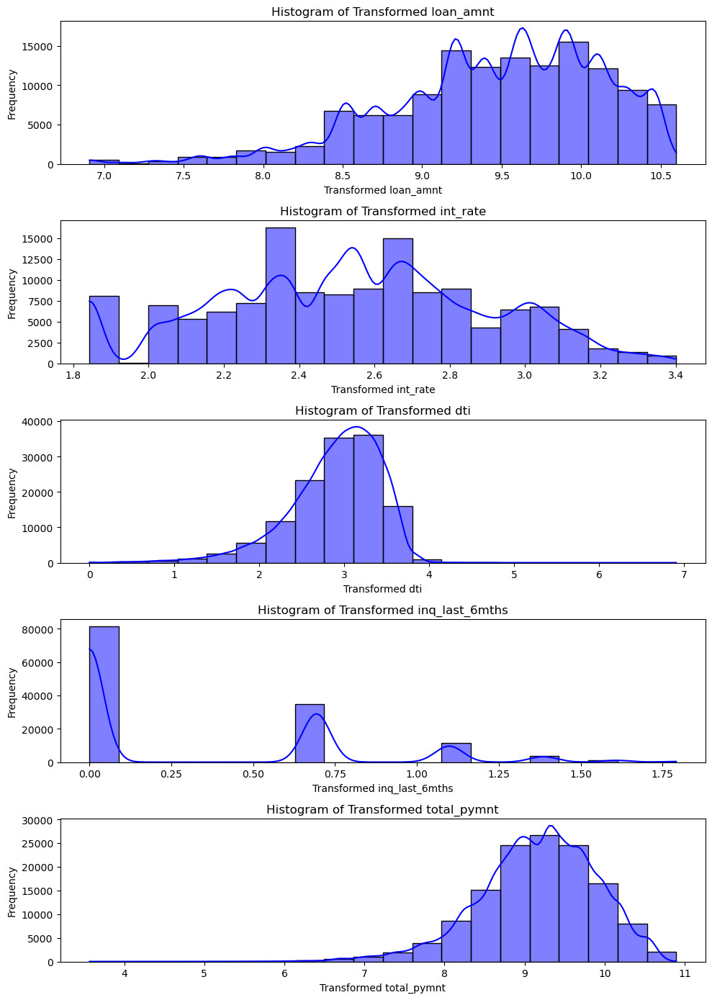

In [76]:
# Columns to plot
columns_to_plot = ['loan_amnt', 'int_rate', 'dti', 'inq_last_6mths', 'total_pymnt']

# Create subplots
fig, axes = plt.subplots(nrows=len(columns_to_plot), ncols=1, figsize=(10, 14))

# Loop through columns and plot histograms
for i, column in enumerate(columns_to_plot):
    sns.histplot(df[column], kde=True, bins=20, color='blue', ax=axes[i])
    axes[i].set_title(f'Histogram of Transformed {column}', fontsize=12)
    axes[i].set_xlabel(f'Transformed {column}', fontsize=10)
    axes[i].set_ylabel('Frequency', fontsize=10)

plt.tight_layout()
plt.show()

In [77]:
# # Loop through the car-related columns and create a box plot for each one
# for column in loan_columns:
#     fig = px.box(df, y=column)
#     fig.update_layout(
#         autosize=False,
#         width=800,
#         height=600,
#         title='Box plot of ' + column,
#         xaxis_title=column,
#         yaxis_title='Value'
#     )

#     # Show the plot
#     fig.show()

##### Observations:

1. Prior to logarithmic transformation it can be observed from the histograms plotted, that the data was .............
2. Logarthmic Transformation has been applied and it can be observed from the histograms that the distribution of the data has become.................

## ------------------------------------------------------------------------------------------------------------------------------------

## 8.Train-Test split and Additional data encoding:

In [78]:
import category_encoders as ce
from sklearn.model_selection import train_test_split

#the columns that we are using
x_columns = ['loan_amnt', 'term', 'int_rate', 'verification_status', 'issue_d','dti', 'inq_last_6mths', 'total_pymnt', 'grade_1', 'grade_2', 'grade_3', 'grade_4', 'grade_5', 'grade_6', 'issue_year']
target_column = 'loan_default'

In [79]:
# Select features (X) and target variable (y)
X = df[x_columns]
y = df[target_column]

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, shuffle=True)

# Target Encoding on Training Set for 'verification_status'
encoder_verification_status = ce.TargetEncoder(cols=['verification_status'])
X_train_encoded = encoder_verification_status.fit_transform(X_train, y_train)

# Apply the Same Encoding to Test Sets for 'verification_status'
X_test_encoded = encoder_verification_status.transform(X_test)

# Target Encoding on Training Set for 'grade_1'
encoder_grade_1 = ce.TargetEncoder(cols=['grade_1'])
X_train_encoded_grade_1 = encoder_grade_1.fit_transform(X_train_encoded, y_train)

# Apply the Same Encoding to Validation and Test Sets for 'grade_1'
X_test_encoded_grade_1 = encoder_grade_1.transform(X_test_encoded)


In [80]:
X_train = X_train_encoded_grade_1 
X_test = X_train_encoded_grade_1

##### Observations:
1. Train-Test split has been performed by dividing the data to 80% Train and 20% test. The data has been shuffled by setting the shuffle parameter to True. It shuffles the data prior to train test split so that the model is exposed to all sorts of data.
2. The columns 'grade_1' and 'verification_status' have been encoded after train-test-split using the target encoder.
3. Target encoding is done after train-test-split to avoid any information leakage from the test set into the encoding process.This approach helps maintain the integrity of the test set.


In [81]:
df

,loan_amnt,term,int_rate,verification_status,issue_d,dti,inq_last_6mths,total_pymnt,loan_default,grade_1,grade_2,grade_3,grade_4,grade_5,grade_6,issue_year
0,9.210440,60,3.021887,1,2016-03-01,2.772589,0.693147,9.317294,0,0,0,1,0,0,0,2016
1,10.463132,60,3.079614,1,2016-03-01,3.257327,0.693147,10.524802,0,0,0,0,1,0,0,2016
2,9.903538,60,2.318458,0,2016-03-01,2.691243,0.693147,9.121367,0,1,0,0,0,0,0,2016
3,9.768584,60,2.523326,1,2016-03-01,3.435921,0.000000,9.039980,0,1,0,0,0,0,0,2016
4,8.987322,36,2.318458,1,2016-03-01,3.162517,0.000000,8.631032,0,1,0,0,0,0,0,2016
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
133827,9.729194,60,2.969902,1,2016-01-01,3.021400,0.000000,9.726839,0,0,0,0,1,0,0,2016
133828,8.885441,36,2.503074,1,2016-01-01,2.736962,0.693147,8.358877,1,1,0,0,0,0,0,2016
133831,9.457279,36,2.651833,1,2016-01-01,3.159975,1.098612,9.287452,0,0,1,0,0,0,0,2016
133832,10.463132,36,2.739549,1,2016-01-01,2.821974,0.000000,10.544774,0,0,1,0,0,0,0,2016


Linear 
regression, decision tree and random forest. Additionally, we will also use Xg Boost

### Before we proceed with data modelling , we are going to check if there are any columns that have extreme values or null values and treat them accordingly to avoid any data misinterpretation in the model 

In [82]:
print(df[df.isin([np.inf, -np.inf]).any(axis=1)]) 

       loan_amnt  term  int_rate  verification_status    issue_d  dti  \
31272   9.615872    36  2.374906                    1 2016-03-01 -inf   

       inq_last_6mths  total_pymnt  loan_default  grade_1  grade_2  grade_3  \
31272             0.0     9.692136             0        1        0        0   

       grade_4  grade_5  grade_6  issue_year  
31272        0        0        0        2016  


In [83]:
print(df[df.isna().any(axis=1)])

Empty DataFrame
Columns: [loan_amnt, term, int_rate, verification_status, issue_d, dti, inq_last_6mths, total_pymnt, loan_default, grade_1, grade_2, grade_3, grade_4, grade_5, grade_6, issue_year]
Index: []


In [84]:
# Drop rows with infinite values
df = df.replace([np.inf, -np.inf], np.nan).dropna()

#fill infinite values with a specific value
df.replace([np.inf, -np.inf], np.nan, inplace=True)

# fill NaN values with the median of each column
df.fillna(df.median(), inplace=True)


### DATA MODELLING

### LINEAR REGRESSION

Validation Accuracy: 0.9687

Validation Confusion Matrix:
[[22814    25]
 [  811  3067]]

Validation Classification Report:
              precision    recall  f1-score   support

           0       0.97      1.00      0.98     22839
           1       0.99      0.79      0.88      3878

    accuracy                           0.97     26717
   macro avg       0.98      0.89      0.93     26717
weighted avg       0.97      0.97      0.97     26717


Test Accuracy: 0.9690

Test Confusion Matrix:
[[22810    29]
 [  799  3079]]

Test Classification Report:
              precision    recall  f1-score   support

           0       0.97      1.00      0.98     22839
           1       0.99      0.79      0.88      3878

    accuracy                           0.97     26717
   macro avg       0.98      0.90      0.93     26717
weighted avg       0.97      0.97      0.97     26717



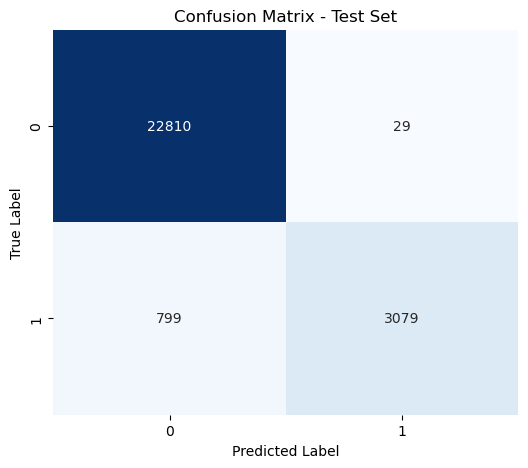

In [85]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
import matplotlib.pyplot as plt
import seaborn as sns


# Specifying features and target variable
features = ['loan_amnt', 'term', 'int_rate', 'verification_status', 'dti', 'inq_last_6mths', 'total_pymnt', 'grade_1', 'grade_2', 'grade_3', 'grade_4', 'grade_5', 'grade_6', 'issue_year']
target = 'loan_default'

# Select features (X) and target variable (y)
X = df[features]
y = df[target]

# Split the data into training, validation, and testing sets
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, random_state=42, stratify=y)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42, stratify=y_temp)

# Initialize the Logistic Regression model
logreg_model = LogisticRegression(random_state=42)

# Train the model on the training set
logreg_model.fit(X_train, y_train)

# Make predictions on the validation set
y_val_pred = logreg_model.predict(X_val)

# Evaluate the model on the validation set
accuracy_val = accuracy_score(y_val, y_val_pred)
conf_matrix_val = confusion_matrix(y_val, y_val_pred)
class_report_val = classification_report(y_val, y_val_pred)

# Print the evaluation metrics for the validation set
print(f"Validation Accuracy: {accuracy_val:.4f}")
print("\nValidation Confusion Matrix:")
print(conf_matrix_val)
print("\nValidation Classification Report:")
print(class_report_val)

# Make predictions on the test set
y_test_pred = logreg_model.predict(X_test)

# Evaluate the model on the test set
accuracy_test = accuracy_score(y_test, y_test_pred)
conf_matrix_test = confusion_matrix(y_test, y_test_pred)
class_report_test = classification_report(y_test, y_test_pred)

# Print the evaluation metrics for the test set
print(f"\nTest Accuracy: {accuracy_test:.4f}")
print("\nTest Confusion Matrix:")
print(conf_matrix_test)
print("\nTest Classification Report:")
print(class_report_test)


# Plot the confusion matrix using seaborn
plt.figure(figsize=(6, 5))
sns.heatmap(conf_matrix_test, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=logreg_model.classes_, yticklabels=logreg_model.classes_)
plt.title('Confusion Matrix - Test Set')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()


##### Observations:

1.  

### DECISION TREE

Validation Set Metrics:
Accuracy: 0.9531

Confusion Matrix:
[[22199   640]
 [  612  3266]]

Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.97      0.97     22839
           1       0.84      0.84      0.84      3878

    accuracy                           0.95     26717
   macro avg       0.90      0.91      0.91     26717
weighted avg       0.95      0.95      0.95     26717


Test Set Metrics:
Accuracy: 0.9561

Confusion Matrix:
[[22274   565]
 [  607  3271]]

Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.98      0.97     22839
           1       0.85      0.84      0.85      3878

    accuracy                           0.96     26717
   macro avg       0.91      0.91      0.91     26717
weighted avg       0.96      0.96      0.96     26717



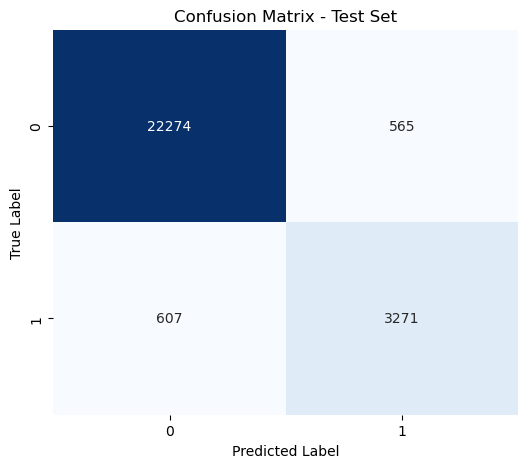

In [86]:
# Specifying features and target variable
features = ['loan_amnt', 'term', 'int_rate', 'verification_status', 'dti', 'inq_last_6mths', 'total_pymnt', 'grade_1', 'grade_2', 'grade_3', 'grade_4', 'grade_5', 'grade_6', 'issue_year']
target = 'loan_default'

# Select features (X) and target variable (y)
X = df[features]
y = df[target]

# Split the data into training (60%) and temporary set (40%)
X_train_temp, X_temp, y_train_temp, y_temp = train_test_split(X, y, test_size=0.4, stratify=y, random_state=42)

# Further split the temporary set into validation (50%) and test (50%)
X_validation, X_test, y_validation, y_test = train_test_split(X_temp, y_temp, test_size=0.5, stratify=y_temp, random_state=42)

# Now, X_train, y_train, X_validation, y_validation, X_test, y_test are ready for training, validation, and testing

# Initialize the Decision Tree model
dt_model = DecisionTreeClassifier(random_state=42)

# Train the model on the training set
dt_model.fit(X_train_temp, y_train_temp)

# Make predictions on the validation set
y_pred_validation = dt_model.predict(X_validation)

# Evaluate the model on the validation set
accuracy_validation = accuracy_score(y_validation, y_pred_validation)
conf_matrix_validation = confusion_matrix(y_validation, y_pred_validation)
class_report_validation = classification_report(y_validation, y_pred_validation)

# Print the evaluation metrics for the validation set
print("Validation Set Metrics:")
print(f"Accuracy: {accuracy_validation:.4f}")
print("\nConfusion Matrix:")
print(conf_matrix_validation)
print("\nClassification Report:")
print(class_report_validation)

# Make predictions on the test set
y_pred_test = dt_model.predict(X_test)

# Evaluate the model on the test set
accuracy_test = accuracy_score(y_test, y_pred_test)
conf_matrix_test = confusion_matrix(y_test, y_pred_test)
class_report_test = classification_report(y_test, y_pred_test)

# Print the evaluation metrics for the test set
print("\nTest Set Metrics:")
print(f"Accuracy: {accuracy_test:.4f}")
print("\nConfusion Matrix:")
print(conf_matrix_test)
print("\nClassification Report:")
print(class_report_test)


# Plot the confusion matrix using seaborn
plt.figure(figsize=(6, 5))
sns.heatmap(conf_matrix_test, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=dt_model.classes_, yticklabels=dt_model.classes_)
plt.title('Confusion Matrix - Test Set')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

##### Observations:

1. A baseline model Decision-tree has been trained.
2. k-fold cross-validation with 5 folds have been used in order to train each fold.
3. The model was evaluated using metrics such as MSE, r2 score. 
4. Based on the results it can be observed that the model overfits. The r2 square on train set is 0.89 while the r2 square on test set is 0.77. It represents that the model is learning too much about the training data and is not generalising well to unseen data.
4. Lastly, important features have been plotted using this model and it can be observed that the features 'Trim' followed by 'Model' and 'car_age' have higher importance and contribute the most to prediction. 

### RANDOM FOREST 

Validation Set Metrics:
Accuracy: 0.9598

Confusion Matrix:
[[22791    48]
 [ 1026  2852]]

Classification Report:
              precision    recall  f1-score   support

           0       0.96      1.00      0.98     22839
           1       0.98      0.74      0.84      3878

    accuracy                           0.96     26717
   macro avg       0.97      0.87      0.91     26717
weighted avg       0.96      0.96      0.96     26717


Test Set Metrics:
Accuracy: 0.9603

Confusion Matrix:
[[22802    37]
 [ 1024  2854]]

Classification Report:
              precision    recall  f1-score   support

           0       0.96      1.00      0.98     22839
           1       0.99      0.74      0.84      3878

    accuracy                           0.96     26717
   macro avg       0.97      0.87      0.91     26717
weighted avg       0.96      0.96      0.96     26717



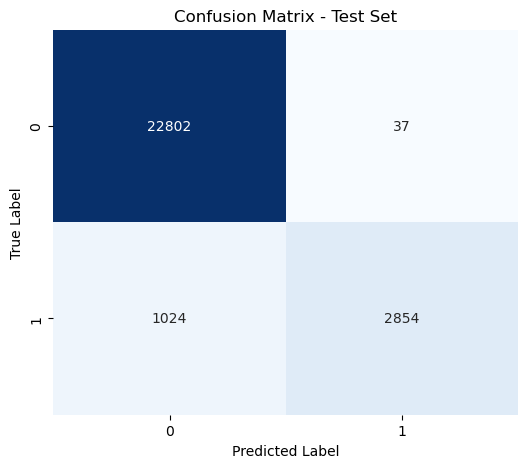

In [87]:
# Specifying features and target variable
features = ['loan_amnt', 'term', 'int_rate', 'verification_status', 'dti', 'inq_last_6mths', 'total_pymnt', 'grade_1', 'grade_2', 'grade_3', 'grade_4', 'grade_5', 'grade_6', 'issue_year']
target = 'loan_default'

# Select features (X) and target variable (y)
X = df[features]
y = df[target]

# Split the data into training (60%), validation (20%), and testing (20%) sets with stratification
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, stratify=y, random_state=42)
X_validation, X_test, y_validation, y_test = train_test_split(X_temp, y_temp, test_size=0.5, stratify=y_temp, random_state=42)

# Initialize the Random Forest model
rf_model = RandomForestClassifier(random_state=42)

# Train the model on the training set
rf_model.fit(X_train, y_train)

# Make predictions on the validation set
y_pred_validation = rf_model.predict(X_validation)

# Evaluate the model on the validation set
accuracy_validation = accuracy_score(y_validation, y_pred_validation)
conf_matrix_validation = confusion_matrix(y_validation, y_pred_validation)
class_report_validation = classification_report(y_validation, y_pred_validation)

# Print the evaluation metrics for the validation set
print("Validation Set Metrics:")
print(f"Accuracy: {accuracy_validation:.4f}")
print("\nConfusion Matrix:")
print(conf_matrix_validation)
print("\nClassification Report:")
print(class_report_validation)

# Make predictions on the test set
y_pred_test = rf_model.predict(X_test)

# Evaluate the model on the test set
accuracy_test = accuracy_score(y_test, y_pred_test)
conf_matrix_test = confusion_matrix(y_test, y_pred_test)
class_report_test = classification_report(y_test, y_pred_test)

# Print the evaluation metrics for the test set
print("\nTest Set Metrics:")
print(f"Accuracy: {accuracy_test:.4f}")
print("\nConfusion Matrix:")
print(conf_matrix_test)
print("\nClassification Report:")
print(class_report_test)


# Plot the confusion matrix using seaborn
plt.figure(figsize=(6, 5))
sns.heatmap(conf_matrix_test, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=rf_model.classes_, yticklabels=rf_model.classes_)
plt.title('Confusion Matrix - Test Set')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()


### Observation

.
.




..
....

## XgBoost

In [88]:
# Specifying features and target variable
features = ['loan_amnt', 'term', 'int_rate', 'verification_status', 'dti', 'inq_last_6mths', 'total_pymnt', 'grade_1', 'grade_2', 'grade_3', 'grade_4', 'grade_5', 'grade_6', 'issue_year']
target = 'loan_default'

# Select features (X) and target variable (y)
X = df[features]
y = df[target]

# Split the data into training (60%), validation (20%), and test (20%) sets with stratification
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, stratify=y, random_state=42)
X_validation, X_test, y_validation, y_test = train_test_split(X_temp, y_temp, test_size=0.5, stratify=y_temp, random_state=42)

# Initialize XGBoost model with the desired evaluation metric
model = xgb.XGBClassifier(
    objective='binary:logistic',
    eval_metric='logloss',  # Specify the evaluation metric for training
    eta=0.1,
    max_depth=3,
    subsample=0.8,
    colsample_bytree=0.8,
    seed=42
)

# Train the model on the training set
model.fit(
    X_train, y_train,
    eval_set=[(X_validation, y_validation)],
    early_stopping_rounds=10
)

# Make predictions on the test set
y_proba = model.predict_proba(X_test)[:, 1]  # Get the predicted probabilities for the positive class

# Convert probabilities to binary predictions using a threshold (e.g., 0.5)
y_pred = (y_proba > 0.5).astype(int)

# Evaluate the model on the test set
accuracy = accuracy_score(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)
class_report = classification_report(y_test, y_pred)

# Print the evaluation metrics for the test set
print("Test Set Metrics:")
print(f"Accuracy: {accuracy:.4f}")
print("\nConfusion Matrix:")
print(conf_matrix)
print("\nClassification Report:")
print(class_report)


[0]	validation_0-logloss:0.63659
[1]	validation_0-logloss:0.58312
[2]	validation_0-logloss:0.53986
[3]	validation_0-logloss:0.50376
[4]	validation_0-logloss:0.47322
[5]	validation_0-logloss:0.44707
[6]	validation_0-logloss:0.42824
[7]	validation_0-logloss:0.41290
[8]	validation_0-logloss:0.39483
[9]	validation_0-logloss:0.38242
[10]	validation_0-logloss:0.37315
[11]	validation_0-logloss:0.36273
[12]	validation_0-logloss:0.35007
[13]	validation_0-logloss:0.34363
[14]	validation_0-logloss:0.33288
[15]	validation_0-logloss:0.32329
[16]	validation_0-logloss:0.31540
[17]	validation_0-logloss:0.30791
[18]	validation_0-logloss:0.30155
[19]	validation_0-logloss:0.29639
[20]	validation_0-logloss:0.28946
[21]	validation_0-logloss:0.28668
[22]	validation_0-logloss:0.28372
[23]	validation_0-logloss:0.28098
[24]	validation_0-logloss:0.27867
[25]	validation_0-logloss:0.27493
[26]	validation_0-logloss:0.27321
[27]	validation_0-logloss:0.27181
[28]	validation_0-logloss:0.27012
[29]	validation_0-loglos

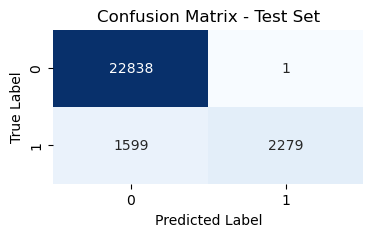

In [89]:
conf_matrix = confusion_matrix(y_test, y_pred)

# Plot the confusion matrix using seaborn
plt.figure(figsize=(4, 2))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=model.classes_, yticklabels=model.classes_)
plt.title('Confusion Matrix - Test Set')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()


### OBSERVATIONS